# Finding the Mass of undiscovered Exoplanets using Transit Timing Variations (TTVs)

**Transit Timing Variation (TTV)** is when a planet's transit across its star occurs slightly earlier or later than it is supposed to. This isn't random; it's a gravitational "wobble" caused by the pull of other planets. A more massive planet creates a stronger pull and a more distinct TTV signal. Our code simulates thousands of these interactions, training a neural network to recognize these gravitational fingerprints and instantly predict a hidden planet's mass from its neighbor's TTVs.


https://youtu.be/rqQ1xKsNIQE?si=cOEgnaN3r4PU6WZI
https://www.youtube.com/watch?v=QBkjKCLv8jA

In [4]:
import numpy as np
import rebound
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

Starting data generation...
  Running simulation 10/50...
  Running simulation 20/50...
  Running simulation 30/50...
  Running simulation 40/50...
  Running simulation 50/50...
Data generation complete. Generated 50 samples.


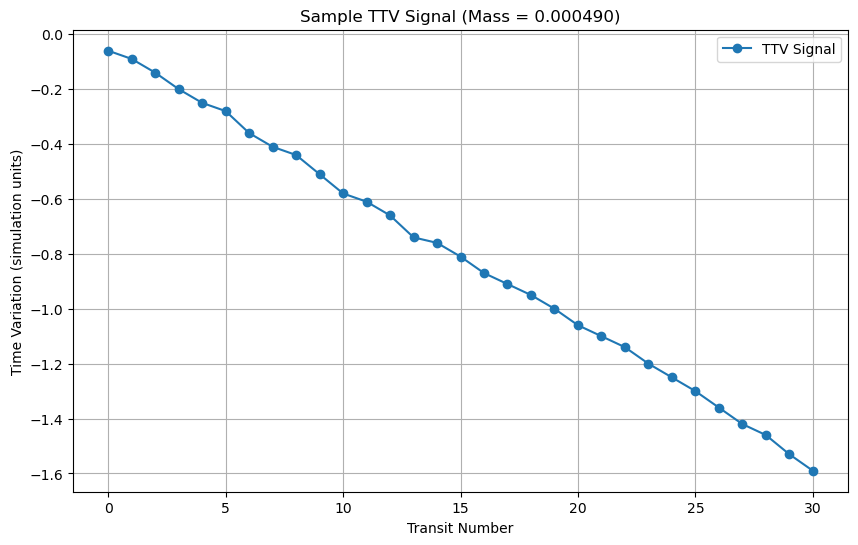


Starting model training...
Epoch [10/50], Train Loss: 0.025433, Val Loss: 0.738107
Epoch [20/50], Train Loss: 0.019481, Val Loss: 0.595545
Epoch [30/50], Train Loss: 0.015069, Val Loss: 0.514905
Epoch [40/50], Train Loss: 0.017767, Val Loss: 0.443142
Early stopping at epoch 44
Training complete.

--- Testing the trained model ---
Test MSE: 0.00000001
Test MAE: 0.00006547

Sample predictions:
  Actual: 0.000325, Predicted: 0.000343
  Actual: 0.000095, Predicted: 0.000166
  Actual: 0.000278, Predicted: 0.000242
  Actual: 0.000369, Predicted: 0.000428
  Actual: 0.000198, Predicted: 0.000310


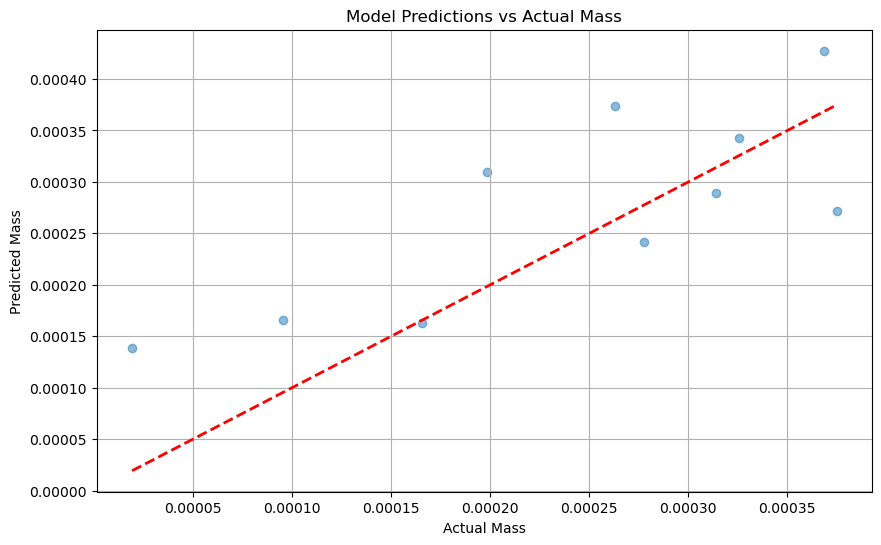

In [6]:
#-----------------------------------------------------------------------------
# Utility Functions
#-----------------------------------------------------------------------------

def detect_transits(sim, planet_index, star_index=0, max_transits=50, integration_time=200):
    """
    Detects transit times by monitoring when the planet crosses in front of the star.
    A transit occurs when the planet's y-coordinate changes sign (crosses y=0 plane).
    """
    transit_times = []
    dt = 0.01  # Small time step for checking transits
    
    star = sim.particles[star_index]
    planet = sim.particles[planet_index]
    
    # Get initial position relative to star
    prev_y = planet.y - star.y
    
    time = 0
    while time < integration_time and len(transit_times) < max_transits:
        sim.integrate(sim.t + dt)
        time = sim.t
        
        # Current position relative to star
        curr_y = planet.y - star.y
        
        # Check if planet crossed the y=0 plane (transit condition)
        # Also check x > 0 to ensure it's crossing in front of the star
        if prev_y * curr_y < 0:  # Sign change
            x_rel = planet.x - star.x
            if x_rel > 0:  # Planet is in front of star
                transit_times.append(time)
        
        prev_y = curr_y
    
    return np.array(transit_times)


def calculate_ttvs(transit_times_perturbed, transit_times_unperturbed):
    """
    Calculates TTVs by subtracting the unperturbed transit times from the perturbed ones.
    """
    min_len = min(len(transit_times_perturbed), len(transit_times_unperturbed))
    if min_len == 0:
        return np.array([])
    ttvs = transit_times_perturbed[:min_len] - transit_times_unperturbed[:min_len]
    return ttvs


#-----------------------------------------------------------------------------
# ### --- PHASE 1: GENERATE TRAINING DATA --- ###
#-----------------------------------------------------------------------------

def generate_simulation_data(num_simulations=50, max_transits=40, integration_time=200):
    """
    Generates training data by running N-body simulations with varying parameters.
    """
    print("Starting data generation...")
    
    # --- The "Ground Truth" Simulation (No Planet C) ---
    try:
        sim_unperturbed = rebound.Simulation()
        sim_unperturbed.add(m=1.0)  # Star A
        sim_unperturbed.add(m=1e-4, a=1.0)  # Planet B using semi-major axis
        sim_unperturbed.move_to_com()       # Shifts all particles so center of mass is at origin
        
        unperturbed_transits = detect_transits(
            sim_unperturbed, planet_index=1, max_transits=max_transits, 
            integration_time=integration_time
        )
        
        if len(unperturbed_transits) < max_transits:
            print(f"Warning: Only found {len(unperturbed_transits)} unperturbed transits")
            max_transits = len(unperturbed_transits)
        
    except Exception as e:              # If something goes wrong itl return empty arrays
        print(f"Error generating unperturbed simulation: {e}")
        return np.array([]), np.array([])

    # --- Generate Perturbed Systems ---
    all_ttvs = []
    all_masses = []
    failed_sims = 0

    for i in range(num_simulations):  # Loop to create multiple simulations with random parameters
        if (i + 1) % 10 == 0:
            print(f"  Running simulation {i+1}/{num_simulations}...")       # Progress update every 10 simulations
        
        try:
            sim = rebound.Simulation()
            sim.add(m=1.0)  # Star A
            sim.add(m=1e-4, a=1.0)  # Planet B (transiting planet)
            
            # Random mass for Planet C
            mass_c = np.random.uniform(1e-5, 5e-4)      # in range [1e-5, 5e-4]
            # Vary orbital period slightly to create different resonances
            period_c = np.random.uniform(1.3, 1.7)
            sim.add(m=mass_c, a=period_c)  # Planet C (perturber) (random mass and orbit)
            sim.move_to_com()

            # Integrate and get transit times
            perturbed_transits = detect_transits(
                sim, planet_index=1, max_transits=max_transits,
                integration_time=integration_time
            )

            # Calculate TTVs
            ttvs = calculate_ttvs(perturbed_transits, unperturbed_transits)

            # Only keep if we have enough transits # If we got enough data, save it
            if len(ttvs) >= max_transits:
                all_ttvs.append(ttvs[:max_transits])
                all_masses.append(mass_c)
            else:
                failed_sims += 1
                
        except Exception as e:      # Catch any errors during simulation
            failed_sims += 1
            if failed_sims <= 3:  # Only print first few errors
                print(f"  Simulation {i+1} failed: {e}")

    print(f"Data generation complete. Generated {len(all_ttvs)} samples.")
    if failed_sims > 0:
        print(f"Failed simulations: {failed_sims}/{num_simulations}")
    
    return np.array(all_ttvs), np.array(all_masses)


#-----------------------------------------------------------------------------
# ### --- PHASE 2: DEFINE AND TRAIN THE MACHINE LEARNING MODEL --- ###
#-----------------------------------------------------------------------------

class MassPredictor(nn.Module):
    """
    Enhanced Neural Network to predict planet mass from TTV signal.
    Uses batch normalization and dropout for better generalization.
    """
    def __init__(self, input_size=40):      # means we expect 40 TTV measurements as input
        super(MassPredictor, self).__init__()
        self.network = nn.Sequential(
            nn.Linear(input_size, 128),     # Outputs 128 numbers, output = weights x input + bias
            nn.BatchNorm1d(128),            # Normalizes 128 outputs (helps to make training stable and faster)
            nn.ReLU(),                      # Rectified Linear Unit, makes negative values = 0, keeps positive values, output = max(0, input)
            nn.Dropout(0.2),                # Randomly sets 20% of inputs to zero (helps prevent overfitting)
            nn.Linear(128, 64),             # Same thing again, now 128 to 64 outputs
            nn.BatchNorm1d(64),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(64, 32),              # Same thing again, now 64 to 32 outputs
            nn.ReLU(),
            nn.Linear(32, 1)                # Final output is a single number (predicted mass)
        )

    def forward(self, x):                   # Defines how data passes through the network, x is input data
        return self.network(x)


def train_model(model, X_train, y_train, X_val, y_val, epochs=50, batch_size=16):           
    """
    Function to train the neural network model.
    X_train, y_train: training data (TTVs)and labels (masses)
    X_val, y_val: validation features (to check overfitting) and validation labels 
    epochs : how many times to loop over the training data
    batch_size : size of mini-batches for training
    Enhanced training loop with validation and early stopping.
    """
    print("\nStarting model training...")
    
    # Convert from Numpy to PyTorch tensors
    X_train_t = torch.tensor(X_train, dtype=torch.float32)
    y_train_t = torch.tensor(y_train, dtype=torch.float32).view(-1, 1) # Reshape to be a column vector
    X_val_t = torch.tensor(X_val, dtype=torch.float32)
    y_val_t = torch.tensor(y_val, dtype=torch.float32).view(-1, 1)

    criterion = nn.MSELoss()                                                            # Mean Squared Error loss function, average of predicted - actual whole squared
    optimizer = optim.Adam(model.parameters(), lr=0.001)                                # Adam optimizer, an advanced version of gradient descent, all the weights and biases in the network
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=5)      # Reduce learning rate if validation loss plateaus # Patience = 5 epochs, will reduce learning rate if no improvement in 5 epochs

    best_val_loss = float('inf')            # Tracks best validation loss seen
    patience_counter = 0                    # Counts epochs without improvement
    max_patience = 10                       # Stop training if no improvement for 10 epochs

    for epoch in range(epochs):             # One epoch = one full loop over the training data
        model.train()                       # Sets model to training mode
        
        # Mini-batch training
        train_loss = 0                      # Accumulates training loss over batches
        indices = torch.randperm(len(X_train_t))    # Shuffle training data indices, PREVENTS FROM LEARNING ANY KIND OF ORDER IN THE DATA
        for i in range(0, len(X_train_t), batch_size): # Processes batch_size samples at a time
            # Extract one batch of data using shuffled indices
            batch_indices = indices[i:i+batch_size]
            batch_X = X_train_t[batch_indices]      
            batch_y = y_train_t[batch_indices]      
            
            outputs = model(batch_X)        # Forward pass: runs data through network to get predictions
            loss = criterion(outputs, batch_y)  # Calculate loss, how wrong are the preditions? compares model outputs to actual labels
            
            optimizer.zero_grad()           # Clear gradients before backward pass
            loss.backward()                # Backpropagation: compute gradients, uses calculus chain rule automatically, dloss/dweight = gradient, for every weight in the network
            optimizer.step()               # Update weights using optimizer, New weights = old weights - learning rate x dloss/dweight
            train_loss += loss.item()       # accumulate loss for this batch, .item() gets the scalar value from the tensor
        
        # Validation
        model.eval()                    # Sets model to evaluation mode
        with torch.no_grad():           # No need to compute gradients during validation
            # Run validation data through the model to get predictions
            val_outputs = model(X_val_t)     
            val_loss = criterion(val_outputs, y_val_t)
        
        scheduler.step(val_loss)        # Adjust learning rate based on validation loss
        
        if (epoch + 1) % 10 == 0:
            print(f'Epoch [{epoch+1}/{epochs}], Train Loss: {train_loss/len(X_train_t):.6f}, Val Loss: {val_loss.item():.6f}')
        
        # Validation loss check for early stopping
        if val_loss < best_val_loss:        # Saves best model and weights if validation loss improved
            best_val_loss = val_loss
            patience_counter = 0
            best_model_state = model.state_dict().copy()        # state_dict() contains all parameters, weights and biases of the model
        else:                                   # No improvement in validation loss
            patience_counter += 1
            if patience_counter >= max_patience:
                print(f"Early stopping at epoch {epoch+1}")
                model.load_state_dict(best_model_state)
                break
    
    print("Training complete.")
    return model


#-----------------------------------------------------------------------------
# ### --- PHASE 3: PUTTING IT ALL TOGETHER --- ###
#-----------------------------------------------------------------------------

if __name__ == "__main__":  # Only runs if this file is executed directly
    # 1. Generate the data
    ttv_features, mass_labels = generate_simulation_data(num_simulations=50, max_transits=40)       # Generate 50 simulations with up to 40 transits each
    
    if len(ttv_features) < 10:  # Merely a safety check
        print("\nNot enough data generated to train. Increase `num_simulations`.")
    else:
        # 2. Normalize the data for better training
        scaler_X = StandardScaler()
        scaler_y = StandardScaler()
        
        ttv_features_scaled = scaler_X.fit_transform(ttv_features)      # Tranforms to have mean 0 and stddev 1
        mass_labels_scaled = scaler_y.fit_transform(mass_labels.reshape(-1, 1)).flatten()
        
        # 3. Train/test split
        X_train, X_test, y_train, y_test = train_test_split(
            ttv_features_scaled, mass_labels_scaled, test_size=0.2, random_state=42         # 20% test data and 80% training data
        )
        
        # Further split training into train and validation
        X_train, X_val, y_train, y_val = train_test_split(
            X_train, y_train, test_size=0.2, random_state=42            # Further splits into 64% train and 16% validation
        )

        # 4. Visualize sample TTV signal
        plt.figure(figsize=(10, 6))
        plt.plot(ttv_features[0], 'o-', label='TTV Signal')
        plt.title(f'Sample TTV Signal (Mass = {mass_labels[0]:.6f})')
        plt.xlabel('Transit Number')
        plt.ylabel('Time Variation (simulation units)')
        plt.legend()
        plt.grid(True)
        plt.show()

        # 5. Train the model
        input_size = ttv_features.shape[1]
        model = MassPredictor(input_size=input_size)                             # Creates NN with correct input size
        model = train_model(model, X_train, y_train, X_val, y_val, epochs=50)    # Train the model for 50 epochs

        # 6. Test the model
        print("\n--- Testing the trained model ---")
        model.eval()
        with torch.no_grad():       # Switching to evulation mode where we dont compute gradients
            X_test_t = torch.tensor(X_test, dtype=torch.float32)    # Convert test data to tensor
            predictions = model(X_test_t).numpy().flatten()         # And back to Numpy array

            # Inverse transform / Denormalize to get actual values
            predictions_actual = scaler_y.inverse_transform(predictions.reshape(-1, 1)).flatten()       
            y_test_actual = scaler_y.inverse_transform(y_test.reshape(-1, 1)).flatten()
            
            # Calculate error metrics
            mse = np.mean((predictions_actual - y_test_actual)**2)
            mae = np.mean(np.abs(predictions_actual - y_test_actual))
            
            print(f"Test MSE: {mse:.8f}")
            print(f"Test MAE: {mae:.8f}")
            print(f"\nSample predictions:")
            for i in range(min(5, len(y_test_actual))):
                print(f"  Actual: {y_test_actual[i]:.6f}, Predicted: {predictions_actual[i]:.6f}")
        
        # 7. Plot 5 example predictions vs actual
        plt.figure(figsize=(10, 6))
        plt.scatter(y_test_actual, predictions_actual, alpha=0.5)
        plt.plot([y_test_actual.min(), y_test_actual.max()], 
                 [y_test_actual.min(), y_test_actual.max()], 'r--', lw=2)
        plt.xlabel('Actual Mass')
        plt.ylabel('Predicted Mass')
        plt.title('Model Predictions vs Actual Mass')
        plt.grid(True)
        plt.show()

# What does it mean?

The y-Axis (Time Variation): This shows how early or late Planet B is for each of its transits compared to a perfectly regular schedule (which would be a straight line at 0.0). A value of 0.0 means the transit was perfectly on time. A negative value (like -0.2) means the transit happened earlier than expected.

The X-Axis (Transit Number): This is just counting the transits of Planet B as they happen, one after another.

The most obvious feature is that the TTV signal is consistently going down. This means that over the course of these 30 transits, Planet B is arriving earlier and earlier each time. This tells you there's a strong, persistent gravitational tug from Planet C that is, on average, pulling Planet B forward and speeding up its orbit.

**The line isn't perfectly straight!** It has subtle oscillations or "wiggles." This is the most important part of the signal! These wiggles are caused by the changing positions of Planet B and Planet C relative to each other.

When Planet C is "behind" Planet B, it pulls it backward, slowing it down slightly (making the TTV less negative). When Planet C is "ahead" of Planet B, it pulls it forward, speeding it up more (making the TTV more negative).



![alt text](output1.png)

This is what the neural network learns. It's not just looking at the final TTV value. It's learning to recognize the entire shape of this curve—the slope, the depth, and the pattern of the wiggles—to figure out that the hidden planet responsible must have a mass of approximately 0.000490

**The Goal:** The red dashed line represents a perfect prediction, where the "Predicted Mass" is exactly equal to the "Actual Mass." The goal is to have the blue dots fall as close to this line as possible.

The most important takeaway is that the blue dots show a clear, positive trend that follows the red line. As the actual mass of the hidden planet gets bigger (moving right on the x-axis), the model's prediction also gets bigger (moving up on the y-axis). This proves that the neural network isn't just guessing randomly; it has successfully learned the fundamental relationship between the TTV signal's shape and the mass of the planet causing it. 

The points are still scattered around the 1:1 line meaning predictions aren’t precise. With only 50 simulations the model is data‑starved, so variance and some bias appears.

![alt text](output2.png)

# GIVE ME MORE SIMULATIONS (my laptop didnt like that) 

We need to run a higher number of simulations, this will take longer, but the resulting dataset will allow the sophisticated neural network to properly learn the subtle differences in the TTV signals and dramatically improve its prediction accuracy. We should see those blue dots get much closer to the red line.

- with 100 simulations, changing dt (time step) to 0.0001, and adding additional parameter of the "orbital period" of planet C, which can contribute to the system dynamics/

Starting data generation...
  Running simulation 10/100...
  Running simulation 20/100...
  Running simulation 30/100...
  Running simulation 40/100...
  Running simulation 50/100...
  Running simulation 60/100...
  Running simulation 70/100...
  Running simulation 80/100...
  Running simulation 90/100...
  Running simulation 100/100...
Data generation complete. Generated 100 samples.


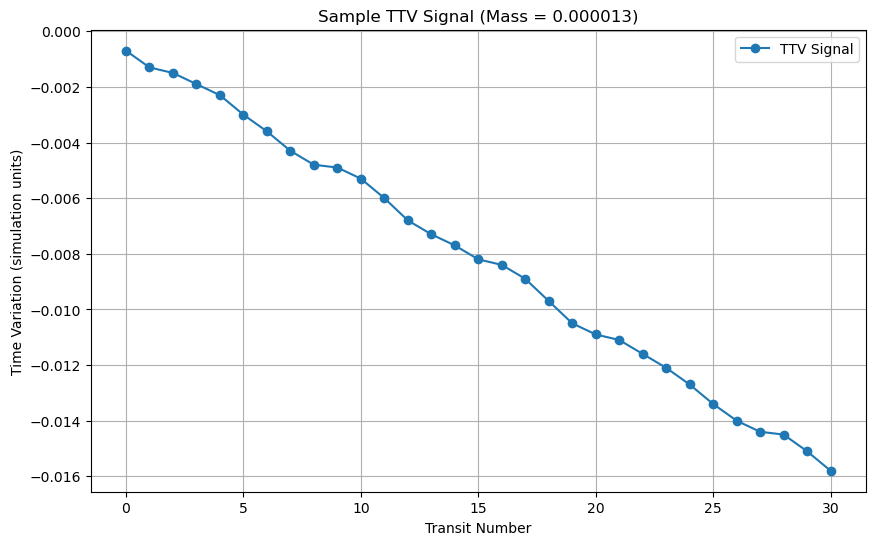


Starting model training...
Epoch [10/50], Train Loss: 0.023003, Val Loss: 0.414975
Epoch [20/50], Train Loss: 0.016705, Val Loss: 0.432061
Epoch [30/50], Train Loss: 0.014105, Val Loss: 0.274953
Early stopping at epoch 39
Training complete.

--- Testing the trained model ---
Test MSE: 0.00000000
Test MAE: 0.00005795

Sample predictions:
  Actual: 0.000478, Predicted: 0.000381
  Actual: 0.000053, Predicted: 0.000089
  Actual: 0.000245, Predicted: 0.000347
  Actual: 0.000123, Predicted: 0.000179
  Actual: 0.000169, Predicted: 0.000139


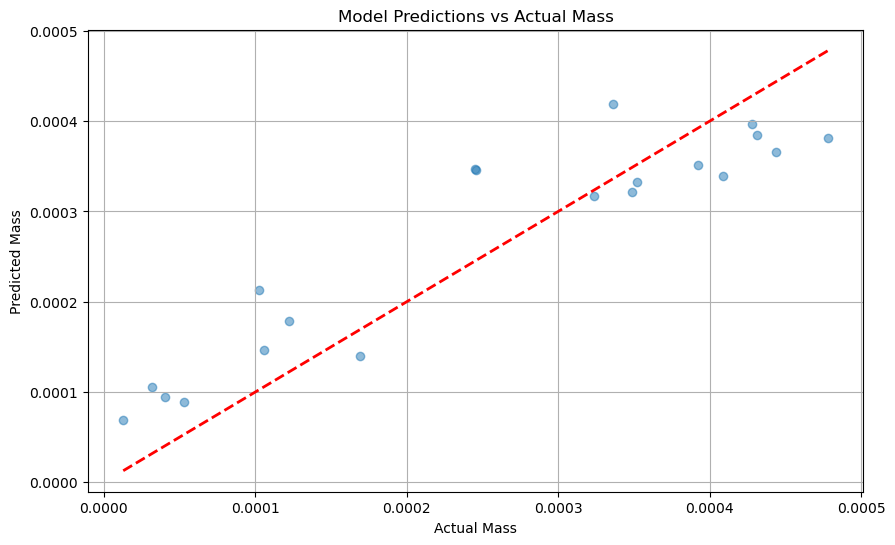

In [ ]:
#-----------------------------------------------------------------------------
# Utility Functions
#-----------------------------------------------------------------------------

def detect_transits(sim, planet_index, star_index=0, max_transits=50, integration_time=200):
    """
    Detects transit times by monitoring when the planet crosses in front of the star.
    A transit occurs when the planet's y-coordinate changes sign (crosses y=0 plane).
    """
    transit_times = []
    dt = 0.0001  # Small time step for checking transits
    
    star = sim.particles[star_index]
    planet = sim.particles[planet_index]
    
    # Get initial position relative to star
    prev_y = planet.y - star.y
    
    time = 0
    while time < integration_time and len(transit_times) < max_transits:
        sim.integrate(sim.t + dt)
        time = sim.t
        
        # Current position relative to star
        curr_y = planet.y - star.y
        
        # Check if planet crossed the y=0 plane (transit condition)
        # Also check x > 0 to ensure it's crossing in front of the star
        if prev_y * curr_y < 0:  # Sign change
            x_rel = planet.x - star.x
            if x_rel > 0:  # Planet is in front of star
                transit_times.append(time)
        
        prev_y = curr_y
    
    return np.array(transit_times)


def calculate_ttvs(transit_times_perturbed, transit_times_unperturbed):
    """
    Calculates TTVs by subtracting the unperturbed transit times from the perturbed ones.
    """
    min_len = min(len(transit_times_perturbed), len(transit_times_unperturbed))
    if min_len == 0:
        return np.array([])
    ttvs = transit_times_perturbed[:min_len] - transit_times_unperturbed[:min_len]
    return ttvs


#-----------------------------------------------------------------------------
# ### --- PHASE 1: GENERATE TRAINING DATA --- ###
#-----------------------------------------------------------------------------

def generate_simulation_data(num_simulations=1000, max_transits=40, integration_time=200):
    """
    Generates training data by running N-body simulations with varying parameters.
    NOW ALSO RETURNS THE ORBITAL PERIODS OF PLANET C!
    """
    print("Starting data generation...")
    
    # --- The "Ground Truth" Simulation (No Planet C) ---
    try:
        sim_unperturbed = rebound.Simulation()
        sim_unperturbed.add(m=1.0)  # Star A
        sim_unperturbed.add(m=1e-4, a=1.0)  # Planet B using semi-major axis
        sim_unperturbed.move_to_com()       # Shifts all particles so center of mass is at origin
        
        unperturbed_transits = detect_transits(
            sim_unperturbed, planet_index=1, max_transits=max_transits, 
            integration_time=integration_time
        )
        
        if len(unperturbed_transits) < max_transits:
            print(f"Warning: Only found {len(unperturbed_transits)} unperturbed transits")
            max_transits = len(unperturbed_transits)
        
    except Exception as e:              # If something goes wrong itl return empty arrays
        print(f"Error generating unperturbed simulation: {e}")
        return np.array([]), np.array([]), np.array([])  # Return 3 empty arrays now

    # --- Generate Perturbed Systems ---
    all_ttvs = []
    all_masses = []
    all_periods = []  # NEW: Store orbital periods of Planet C
    failed_sims = 0

    for i in range(num_simulations):  # Loop to create multiple simulations with random parameters
        if (i + 1) % 10 == 0:
            print(f"  Running simulation {i+1}/{num_simulations}...")       # Progress update every 10 simulations
        
        try:
            sim = rebound.Simulation()
            sim.add(m=1.0)  # Star A
            sim.add(m=1e-4, a=1.0)  # Planet B (transiting planet)
            
            # Random mass for Planet C
            mass_c = np.random.uniform(1e-5, 5e-4)      # in range [1e-5, 5e-4]
            # Vary orbital period slightly to create different resonances
            period_c = np.random.uniform(1.3, 1.7)  # This is the semi-major axis, directly related to period
            sim.add(m=mass_c, a=period_c)  # Planet C (perturber) (random mass and orbit)
            sim.move_to_com()

            # Integrate and get transit times
            perturbed_transits = detect_transits(
                sim, planet_index=1, max_transits=max_transits,
                integration_time=integration_time
            )

            # Calculate TTVs
            ttvs = calculate_ttvs(perturbed_transits, unperturbed_transits)

            # Only keep if we have enough transits # If we got enough data, save it
            if len(ttvs) >= max_transits:
                all_ttvs.append(ttvs[:max_transits])
                all_masses.append(mass_c)
                all_periods.append(period_c)  # NEW: Store the period
            else:
                failed_sims += 1
                
        except Exception as e:      # Catch any errors during simulation
            failed_sims += 1
            if failed_sims <= 3:  # Only print first few errors
                print(f"  Simulation {i+1} failed: {e}")

    print(f"Data generation complete. Generated {len(all_ttvs)} samples.")
    if failed_sims > 0:
        print(f"Failed simulations: {failed_sims}/{num_simulations}")
    
    return np.array(all_ttvs), np.array(all_masses), np.array(all_periods)  # Return periods too


#-----------------------------------------------------------------------------
# ### --- PHASE 2: DEFINE AND TRAIN THE MACHINE LEARNING MODEL --- ###
#-----------------------------------------------------------------------------

class MassPredictor(nn.Module):
    """
    Enhanced Neural Network to predict planet mass from TTV signal.
    Uses batch normalization and dropout for better generalization.
    """
    def __init__(self, input_size=40):      # means we expect 40 TTV measurements as input
        super(MassPredictor, self).__init__()
        self.network = nn.Sequential(
            nn.Linear(input_size, 128),     # Outputs 128 numbers, output = weights x input + bias
            nn.BatchNorm1d(128),            # Normalizes 128 outputs (helps to make training stable and faster)
            nn.ReLU(),                      # Rectified Linear Unit, makes negative values = 0, keeps positive values, output = max(0, input)
            nn.Dropout(0.2),                # Randomly sets 20% of inputs to zero (helps prevent overfitting)
            nn.Linear(128, 64),             # Same thing again, now 128 to 64 outputs
            nn.BatchNorm1d(64),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(64, 32),              # Same thing again, now 64 to 32 outputs
            nn.ReLU(),
            nn.Linear(32, 1)                # Final output is a single number (predicted mass)
        )

    def forward(self, x):                   # Defines how data passes through the network, x is input data
        return self.network(x)


def train_model(model, X_train, y_train, X_val, y_val, epochs=50, batch_size=16):           
    """
    Function to train the neural network model.
    X_train, y_train: training data (TTVs)and labels (masses)
    X_val, y_val: validation features (to check overfitting) and validation labels 
    epochs : how many times to loop over the training data
    batch_size : size of mini-batches for training
    Enhanced training loop with validation and early stopping.
    """
    print("\nStarting model training...")
    
    # Convert from Numpy to PyTorch tensors
    X_train_t = torch.tensor(X_train, dtype=torch.float32)
    y_train_t = torch.tensor(y_train, dtype=torch.float32).view(-1, 1) # Reshape to be a column vector
    X_val_t = torch.tensor(X_val, dtype=torch.float32)
    y_val_t = torch.tensor(y_val, dtype=torch.float32).view(-1, 1)

    criterion = nn.MSELoss()                                                            # Mean Squared Error loss function, average of predicted - actual whole squared
    optimizer = optim.Adam(model.parameters(), lr=0.001)                                # Adam optimizer, an advanced version of gradient descent, all the weights and biases in the network
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=5)      # Reduce learning rate if validation loss plateaus # Patience = 5 epochs, will reduce learning rate if no improvement in 5 epochs

    best_val_loss = float('inf')            # Tracks best validation loss seen
    patience_counter = 0                    # Counts epochs without improvement
    max_patience = 10                       # Stop training if no improvement for 10 epochs

    for epoch in range(epochs):             # One epoch = one full loop over the training data
        model.train()                       # Sets model to training mode
        
        # Mini-batch training
        train_loss = 0                      # Accumulates training loss over batches
        indices = torch.randperm(len(X_train_t))    # Shuffle training data indices, PREVENTS FROM LEARNING ANY KIND OF ORDER IN THE DATA
        for i in range(0, len(X_train_t), batch_size): # Processes batch_size samples at a time
            # Extract one batch of data using shuffled indices
            batch_indices = indices[i:i+batch_size]
            batch_X = X_train_t[batch_indices]      
            batch_y = y_train_t[batch_indices]      
            
            outputs = model(batch_X)        # Forward pass: runs data through network to get predictions
            loss = criterion(outputs, batch_y)  # Calculate loss, how wrong are the preditions? compares model outputs to actual labels
            
            optimizer.zero_grad()           # Clear gradients before backward pass
            loss.backward()                # Backpropagation: compute gradients, uses calculus chain rule automatically, dloss/dweight = gradient, for every weight in the network
            optimizer.step()               # Update weights using optimizer, New weights = old weights - learning rate x dloss/dweight
            train_loss += loss.item()       # accumulate loss for this batch, .item() gets the scalar value from the tensor
        
        # Validation
        model.eval()                    # Sets model to evaluation mode
        with torch.no_grad():           # No need to compute gradients during validation
            # Run validation data through the model to get predictions
            val_outputs = model(X_val_t)     
            val_loss = criterion(val_outputs, y_val_t)
        
        scheduler.step(val_loss)        # Adjust learning rate based on validation loss
        
        if (epoch + 1) % 10 == 0:
            print(f'Epoch [{epoch+1}/{epochs}], Train Loss: {train_loss/len(X_train_t):.6f}, Val Loss: {val_loss.item():.6f}')
        
        # Validation loss check for early stopping
        if val_loss < best_val_loss:        # Saves best model and weights if validation loss improved
            best_val_loss = val_loss
            patience_counter = 0
            best_model_state = model.state_dict().copy()        # state_dict() contains all parameters, weights and biases of the model
        else:                                   # No improvement in validation loss
            patience_counter += 1
            if patience_counter >= max_patience:
                print(f"Early stopping at epoch {epoch+1}")
                model.load_state_dict(best_model_state)
                break
    
    print("Training complete.")
    return model


#-----------------------------------------------------------------------------
# ### --- PHASE 3: PUTTING IT ALL TOGETHER --- ###
#-----------------------------------------------------------------------------

if __name__ == "__main__":  # Only runs if this file is executed directly
    # 1. Generate the data (NOW WITH PERIODS!)
    ttv_features, mass_labels, period_labels = generate_simulation_data(num_simulations=100, max_transits=40)
    
    if len(ttv_features) < 10:  # Merely a safety check
        print("\nNot enough data generated to train. Increase `num_simulations`.")
    else:
        # 2. Normalize the data for better training
        scaler_X = StandardScaler()
        scaler_y = StandardScaler()
        
        ttv_features_scaled = scaler_X.fit_transform(ttv_features)      # Tranforms to have mean 0 and stddev 1
        mass_labels_scaled = scaler_y.fit_transform(mass_labels.reshape(-1, 1)).flatten()
        
        # 3. Train/test split (NOW ALSO SPLITTING PERIODS!)
        # We need to track which periods correspond to which test samples
        X_train, X_test, y_train, y_test, periods_train, periods_test = train_test_split(
            ttv_features_scaled, mass_labels_scaled, period_labels, 
            test_size=0.2, random_state=42         # 20% test data and 80% training data
        )
        
        # Further split training into train and validation
        X_train, X_val, y_train, y_val, periods_train, periods_val = train_test_split(
            X_train, y_train, periods_train, 
            test_size=0.2, random_state=42            # Further splits into 64% train and 16% validation
        )

        # 4. Visualize sample TTV signal
        plt.figure(figsize=(10, 6))
        plt.plot(ttv_features[0], 'o-', label='TTV Signal')
        plt.title(f'Sample TTV Signal (Mass = {mass_labels[0]:.6f})')
        plt.xlabel('Transit Number')
        plt.ylabel('Time Variation (simulation units)')
        plt.legend()
        plt.grid(True)
        plt.show()

        # 5. Train the model
        input_size = ttv_features.shape[1]
        model = MassPredictor(input_size=input_size)                             # Creates NN with correct input size
        model = train_model(model, X_train, y_train, X_val, y_val, epochs=50)    # Train the model for 50 epochs

        # 6. Test the model
        print("\n--- Testing the trained model ---")
        model.eval()
        with torch.no_grad():       # Switching to evulation mode where we dont compute gradients
            X_test_t = torch.tensor(X_test, dtype=torch.float32)    # Convert test data to tensor
            predictions = model(X_test_t).numpy().flatten()         # And back to Numpy array

            # Inverse transform / Denormalize to get actual values
            predictions_actual = scaler_y.inverse_transform(predictions.reshape(-1, 1)).flatten()       
            y_test_actual = scaler_y.inverse_transform(y_test.reshape(-1, 1)).flatten()
            
            # Calculate error metrics
            mse = np.mean((predictions_actual - y_test_actual)**2)
            mae = np.mean(np.abs(predictions_actual - y_test_actual))
            
            print(f"Test MSE: {mse:.8f}")
            print(f"Test MAE: {mae:.8f}")
            print(f"\nSample predictions:")
            for i in range(min(5, len(y_test_actual))):
                print(f"  Actual: {y_test_actual[i]:.6f}, Predicted: {predictions_actual[i]:.6f}")
        
        # 7. Plot predictions vs actual
        plt.figure(figsize=(10, 6))
        plt.scatter(y_test_actual, predictions_actual, alpha=0.5)
        plt.plot([y_test_actual.min(), y_test_actual.max()], 
                 [y_test_actual.min(), y_test_actual.max()], 'r--', lw=2)
        plt.xlabel('Actual Mass')
        plt.ylabel('Predicted Mass')
        plt.title('Model Predictions vs Actual Mass')
        plt.grid(True)
        plt.show()

Much better! Here the transits seem to be occuring earlier and earlier as time goes on suggesting a clear gravitational influence of a "Planet C". The model has learned to predict the mass with more accuracy, however the sample size of the dataset (100 simulations) is still too small for the model to have enough examples across the full mass/period space, which produces the scatter and systematic errors at some masses.. It would be ideal to run alteast 1000 simulations for the model to really capture the transit phenomenon. 

# Adding more parameters

Right now, we are only feeding our model with TTVs which vary over a sequence of data points collected, recorded, or measured over time at regular intervals (otherwise called **time series**). In TTV analysis, different physical system setups can sometimes produce very similar-looking TTV signals. For example:

- Case 1: A relatively small (low-mass) planet C, but in a particular orbit (close to resonance, high eccentricity, etc.) can cause a TTV signal of a certain shape and amplitude on planet B.

- Case 2: A more massive planet C, but in a different orbit (further from resonance, more circular, different phase), can create almost the same TTV signal shape/amplitude on planet B.

If we give our model only the TTV signal, it is "ambiguous" and the model doesn’t know which possible system caused it, so it might predict the wrong mass.

Which is why, we will now add more physical parameters, to break that ambiguity to some degree:

- **Mean anomaly / initial phase (phase of C relative to B)**

    Why: the same mass and period produce TTV signals with the same amplitude but different phase (i.e., where wiggles occur). `Phase shifts` can change the apparent slope or shape of the recorded TTV series.

    What it fixes: prevents the model from averaging over phase and blurring predictions. Represent angles as sin(phase), cos(phase) to avoid wrap issues.

    Know more: https://www.youtube.com/watch?v=_FjdXht-pH4

- **Eccentricity (e_b, e_c) and argument of periastron (ω)**

    Why: eccentric orbits introduce harmonics, asymmetric timing signatures, and can amplify or suppress TTVs at certain phases. ω determines where in the orbit those effects show up.

    What it fixes: reduces confusion between a circular heavier perturber and an eccentric lighter one (they can mimic each other’s TTV amplitude/shape).

    Know more: https://youtu.be/_WdUo45gTuQ?si=g9AAjVwBgiP9LzOv

- **Inclination and Mutual inclination**

    Why: inclination affects whether the planet transits at all, the chord of the transit (duration), and small timing offsets from projected motion. Mutual inclination changes the 3D geometry and can alter TDV and the TTV pattern.

    What it fixes: helps separating geometry effects from mass effects.

    Know more: https://youtu.be/878mPKAC6Gs?si=LO0ioKm_dsAeOIPB
               https://www.youtube.com/watch?v=JMjEFgnifXE 












**This lets the model distinguish between cases where the same TTV comes from different masses but different orbits (previously ambiguous).**

**Formulas used:**

**1. Kepler's Third Law: Orbital Period**
$$
P = a^{3/2}
$$
Where  
$P$ = orbital period (in code: $P_b, P_c$)  
$a$ = semi-major axis (in code: $a_b, a_c$)  
Assume stellar mass $M_* = 1$ in code's units.

---

**2. Period Ratio**
$$
\text{period\_ratio} = \frac{P_c}{P_b}
$$
Where $P_c$ and $P_b$ are the periods of planet C and B.

---

**3. Transit Timing Variation (TTV)**
$$
\text{TTV}_i = t_{i,\text{perturbed}} - t_{i,\text{unperturbed}}
$$
Where $t_{i,*}$ is the $i$th transit time for the given simulation.

---

**4. Phase Difference (Mean Anomaly)**
$$
\Delta M = M_c - M_b
$$
Often encoded for input as:
$$
\sin(\Delta M), \quad \cos(\Delta M)
$$

---

**5. Sine and Cosine Encoding for Angles**
$$
\sin(\theta), \quad \cos(\theta)
$$
Where $\theta$ includes: arguments of periapsis ($\omega_b, \omega_c$), mean anomaly, and inclination ($i_c$).

---

**6. Mutual Inclination**
$$
\cos(\Phi) = \cos(i_1)\cos(i_2) + \sin(i_1)\sin(i_2)\cos(\Omega_1 - \Omega_2)
$$
Where $\Phi$ is mutual inclination between two orbits.

---

**Machine Learning Formulas**

**7. Standardization (Z-score Normalization)**
$$
x_\text{scaled} = \frac{x - \mu}{\sigma}
$$
Where $\mu$ is the dataset mean and $\sigma$ the standard deviation.

---

**8. Mean Squared Error (MSE) Loss**
$$
\text{MSE} = \frac{1}{N} \sum_{i=1}^{N} (y_{\text{pred},i} - y_{\text{true},i})^2
$$
Where $N$ is the number of samples, $y_{\text{pred},i}$ the predicted value, and $y_{\text{true},i}$ the true value.

---

**9. Mean Absolute Error (MAE)**
$$
\text{MAE} = \frac{1}{N} \sum_{i=1}^{N} |y_{\text{pred},i} - y_{\text{true},i}|
$$

---

**10. Neural network layer (fully connected)**
$$
\mathbf{h}^{(l+1)} = f(\mathbf{W}^{(l)} \mathbf{h}^{(l)} + \mathbf{b}^{(l)})
$$
Where $f$ is an activation function (e.g. ReLU), $\mathbf{W}$ and $\mathbf{b}$ are weights and bias.

---

**11. ReLU Activation (Rectified Linear Unit)**
$$
z = \max(0, x)
$$

---

# 1000 SIMULATIONS with all the parameters!!!

Starting data generation with extra physical parameters...
  Running simulation 10/1000...
  Running simulation 20/1000...
  Running simulation 30/1000...
  Running simulation 40/1000...
  Running simulation 50/1000...
  Running simulation 60/1000...
  Running simulation 70/1000...
  Running simulation 80/1000...
  Running simulation 90/1000...
  Running simulation 100/1000...
  Running simulation 110/1000...
  Running simulation 120/1000...
  Running simulation 130/1000...
  Running simulation 140/1000...
  Running simulation 150/1000...
  Running simulation 160/1000...
  Running simulation 170/1000...
  Running simulation 180/1000...
  Running simulation 190/1000...
  Running simulation 200/1000...
  Running simulation 210/1000...
  Running simulation 220/1000...
  Running simulation 230/1000...
  Running simulation 240/1000...
  Running simulation 250/1000...
  Running simulation 260/1000...
  Running simulation 270/1000...
  Running simulation 280/1000...
  Running simulation 290/1

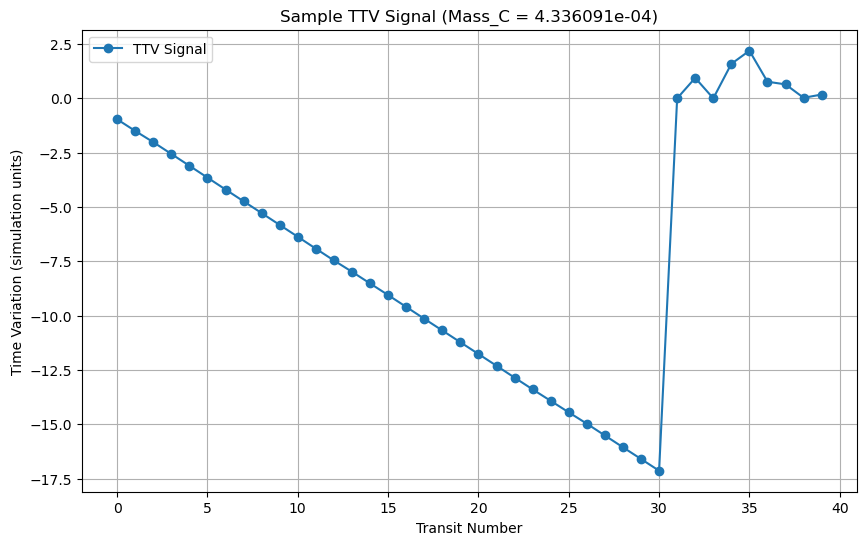


Starting model training...
Epoch [10/50], Train Loss: 0.12361877, Val Loss: 0.02847981
Epoch [20/50], Train Loss: 0.13153796, Val Loss: 0.03066877
Early stopping at epoch 27
Training complete.

--- Testing the trained model ---
Test MSE: 0.0000000003
Test MAE: 0.0000149176

Sample predictions:
  Actual: 7.700247e-05, Predicted: 8.032358e-05
  Actual: 3.126094e-05, Predicted: 4.375229e-05
  Actual: 3.613951e-05, Predicted: 7.155512e-05
  Actual: 3.615629e-04, Predicted: 3.773171e-04
  Actual: 4.721531e-04, Predicted: 4.517629e-04


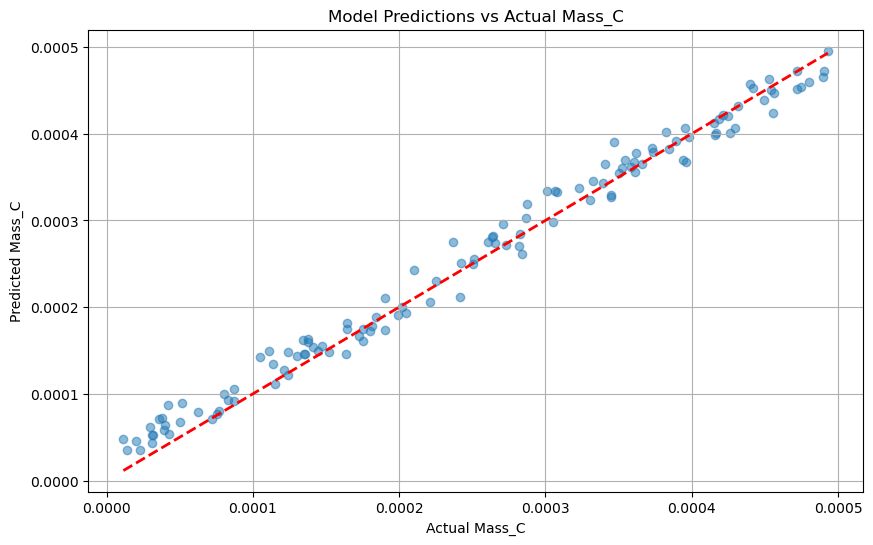

In [ ]:
#-------------------------------------------------------------------------------
# Transit detection (unchanged logic; works with small inclinations)
#-------------------------------------------------------------------------------
def detect_transits(sim, planet_index, star_index=0, max_transits=50, integration_time=200):
    transit_times = []
    dt = 0.0001
    star = sim.particles[star_index]
    planet = sim.particles[planet_index]
    prev_y = planet.y - star.y
    time = 0
    while time < integration_time and len(transit_times) < max_transits:
        sim.integrate(sim.t + dt)
        time = sim.t
        curr_y = planet.y - star.y
        if prev_y * curr_y < 0:
            x_rel = planet.x - star.x
            if x_rel > 0:
                transit_times.append(time)
        prev_y = curr_y
    return np.array(transit_times)

def calculate_ttvs(transit_times_perturbed, transit_times_unperturbed):
    min_len = min(len(transit_times_perturbed), len(transit_times_unperturbed))
    if min_len == 0:
        return np.array([])
    ttvs = transit_times_perturbed[:min_len] - transit_times_unperturbed[:min_len]
    return ttvs

#-------------------------------------------------------------------------------
# Data generator with extra physical parameters encoded as features
#-------------------------------------------------------------------------------
def generate_simulation_data(num_simulations=1000, max_transits=40, integration_time=200):
    """
    Returns:
      features: shape (N, max_transits + n_phys)  # first max_transits columns = TTVs
      masses_c: shape (N,)                        # label = mass of planet C
      periods_c: shape (N,)                       # for bookkeeping/analysis
    Physical features appended (example order):
      [m_b, a_b, m_c, a_c, period_ratio, sin(dM), cos(dM),
       e_b, e_c, sin(omega_b), cos(omega_b), sin(omega_c), cos(omega_c),
       sin(inc_c), cos(inc_c)]
    """
    print("Starting data generation with extra physical parameters...")
    # Ground-truth (unperturbed) system (planet B only)
    try:
        sim_unperturbed = rebound.Simulation()
        sim_unperturbed.add(m=1.0)              # Star
        sim_unperturbed.add(m=1e-4, a=1.0)      # Planet B nominal
        sim_unperturbed.move_to_com()
        unperturbed_transits = detect_transits(sim_unperturbed, planet_index=1,
                                               max_transits=max_transits, integration_time=integration_time)
        if len(unperturbed_transits) < max_transits:
            print(f"Warning: Only found {len(unperturbed_transits)} unperturbed transits (max_transits={max_transits})")
            max_transits = len(unperturbed_transits)
    except Exception as e:
        print(f"Error generating unperturbed sim: {e}")
        return np.array([]), np.array([]), np.array([])

    all_features = []
    all_masses = []
    all_periods = []
    failed_sims = 0

    for i in range(num_simulations):
        if (i + 1) % 10 == 0:
            print(f"  Running simulation {i+1}/{num_simulations}...")
        try:
            # Sample physical parameters
            # Planet B (the transiting planet) - allow modest variation
            a_b = np.random.uniform(0.9, 1.1)                      # semi-major axis for B (around 1.0)
            m_b = np.random.uniform(0.5e-4, 1.5e-4)                # mass B ±50%
            e_b = np.random.uniform(0.0, 0.2)                      # eccentricity B
            omega_b = np.random.uniform(0.0, 2*np.pi)             # arg of periastron B
            M_b = np.random.uniform(0.0, 2*np.pi)                 # mean anomaly B
            inc_b = np.deg2rad(np.random.normal(0.0, 1.0))        # small inclination for B (radians)

            # Planet C (perturber)
            a_c = np.random.uniform(1.2, 2.0)                     # sample a_c from 1.2-2.0 as requested
            m_c = np.random.uniform(1e-5, 5e-4)                   # mass C
            e_c = np.random.uniform(0.0, 0.2)                     # eccentricity C
            omega_c = np.random.uniform(0.0, 2*np.pi)              # arg of periastron C
            M_c = np.random.uniform(0.0, 2*np.pi)               # mean anomaly C
            inc_c_deg = np.clip(np.random.normal(0.0, 2.5), -5.0, 5.0)  # mutual/small inclination around 0 ± 5 degrees (sampled as small normal, clipped to ±5 deg)
            inc_c = np.deg2rad(inc_c_deg)

            # Compute orbital periods using Kepler's third law (for m_star = 1): P ∝ a^(3/2)
            P_b = a_b**1.5
            P_c = a_c**1.5
            period_ratio = P_c / P_b

            # Build simulation
            sim = rebound.Simulation()
            sim.add(m=1.0)  # star
            # Add planet B with orbital elements
            sim.add(m=m_b, a=a_b, e=e_b, inc=inc_b, omega=omega_b, M=M_b)
            # Add planet C with orbital elements
            sim.add(m=m_c, a=a_c, e=e_c, inc=inc_c, omega=omega_c, M=M_c)
            sim.move_to_com()

            # Integrate and extract transits for the perturbed system
            perturbed_transits = detect_transits(sim, planet_index=1,
                                                max_transits=max_transits, integration_time=integration_time)
            ttvs = calculate_ttvs(perturbed_transits, unperturbed_transits)

            if len(ttvs) >= max_transits:
                ttv_vec = ttvs[:max_transits]

                # Encode phase difference (M_c - M_b) as sin/cos to avoid wrap issues
                dM = M_c - M_b
                sin_dM = np.sin(dM)
                cos_dM = np.cos(dM)

                # Encode omega and inclination as sin/cos
                sin_omega_b = np.sin(omega_b); cos_omega_b = np.cos(omega_b)
                sin_omega_c = np.sin(omega_c); cos_omega_c = np.cos(omega_c)
                sin_inc_c = np.sin(inc_c); cos_inc_c = np.cos(inc_c)

                phys_features = np.array([
                    m_b, a_b,
                    m_c, a_c,
                    period_ratio,
                    sin_dM, cos_dM,
                    e_b, e_c,
                    sin_omega_b, cos_omega_b,
                    sin_omega_c, cos_omega_c,
                    sin_inc_c, cos_inc_c
                ], dtype=float)

                sample_features = np.concatenate([ttv_vec, phys_features])
                all_features.append(sample_features)
                all_masses.append(m_c)
                all_periods.append(P_c)
            else:
                failed_sims += 1

        except Exception as e:
            failed_sims += 1
            if failed_sims <= 5:
                print(f"  Simulation {i+1} failed: {e}")

    print(f"Data generation complete. Generated {len(all_features)} samples. Failed: {failed_sims}/{num_simulations}")
    if len(all_features) == 0:
        return np.array([]), np.array([]), np.array([])

    return np.array(all_features), np.array(all_masses), np.array(all_periods)

#-------------------------------------------------------------------------------
# Neural network (unchanged architecture but note dynamic input size)
#-------------------------------------------------------------------------------
class MassPredictor(nn.Module):
    def __init__(self, input_size):
        super(MassPredictor, self).__init__()
        self.network = nn.Sequential(
            nn.Linear(input_size, 128),
            nn.BatchNorm1d(128),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(128, 64),
            nn.BatchNorm1d(64),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(64, 32),
            nn.ReLU(),
            nn.Linear(32, 1)
        )

    def forward(self, x):
        return self.network(x)

# Training function (same as before)
def train_model(model, X_train, y_train, X_val, y_val, epochs=50, batch_size=16):
    print("\nStarting model training...")
    X_train_t = torch.tensor(X_train, dtype=torch.float32)
    y_train_t = torch.tensor(y_train, dtype=torch.float32).view(-1, 1)
    X_val_t = torch.tensor(X_val, dtype=torch.float32)
    y_val_t = torch.tensor(y_val, dtype=torch.float32).view(-1, 1)

    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=0.001)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=5)

    best_val_loss = float('inf')
    patience_counter = 0
    max_patience = 10

    for epoch in range(epochs):
        model.train()
        train_loss = 0.0
        indices = torch.randperm(len(X_train_t))
        for i in range(0, len(X_train_t), batch_size):
            batch_indices = indices[i:i+batch_size]
            batch_X = X_train_t[batch_indices]
            batch_y = y_train_t[batch_indices]
            outputs = model(batch_X)
            loss = criterion(outputs, batch_y)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            train_loss += loss.item() * len(batch_X)

        model.eval()
        with torch.no_grad():
            val_outputs = model(X_val_t)
            val_loss = criterion(val_outputs, y_val_t)

        scheduler.step(val_loss)

        if (epoch + 1) % 10 == 0:
            print(f'Epoch [{epoch+1}/{epochs}], Train Loss: {train_loss/len(X_train_t):.8f}, Val Loss: {val_loss.item():.8f}')

        if val_loss < best_val_loss:
            best_val_loss = val_loss
            patience_counter = 0
            best_model_state = {k: v.clone() for k, v in model.state_dict().items()}
        else:
            patience_counter += 1
            if patience_counter >= max_patience:
                print(f"Early stopping at epoch {epoch+1}")
                model.load_state_dict(best_model_state)
                break

    print("Training complete.")
    return model

#-------------------------------------------------------------------------------
# Main block: generate data, scale, train, evaluate
#-------------------------------------------------------------------------------
if __name__ == "__main__":
    # 1. Generate data with extended physical parameters
    features, mass_labels, period_labels = generate_simulation_data(num_simulations=1000, max_transits=40, integration_time=200)

    if len(features) < 10:
        print("\nNot enough data generated to train. Increase `num_simulations` or check failures.")
    else:
        # 2. Separate raw TTVs (for plotting) from physical features (optional)
        max_transits = 40
        raw_ttv = features[:, :max_transits]           # raw TTVs before scaling
        phys_part = features[:, max_transits:]         # additional physical features appended

        # 3. Scale features and labels
        scaler_X = StandardScaler()
        scaler_y = StandardScaler()
        X_scaled = scaler_X.fit_transform(features)    # scale entire feature vector
        y_scaled = scaler_y.fit_transform(mass_labels.reshape(-1, 1)).flatten()

        # 4. Train/test split (also keep period labels for analysis)
        X_train, X_test, y_train, y_test, periods_train, periods_test = train_test_split(
            X_scaled, y_scaled, period_labels, test_size=0.2, random_state=42
        )

        # 5. Further split training into train/val
        X_train, X_val, y_train, y_val, periods_train, periods_val = train_test_split(
            X_train, y_train, periods_train, test_size=0.2, random_state=42
        )

        # 6. Visualize a sample raw TTV signal (unscaled)
        plt.figure(figsize=(10, 6))
        plt.plot(raw_ttv[0], 'o-', label='TTV Signal')
        plt.title(f'Sample TTV Signal (Mass_C = {mass_labels[0]:.6e})')
        plt.xlabel('Transit Number')
        plt.ylabel('Time Variation (simulation units)')
        plt.legend()
        plt.grid(True)
        plt.show()

        # 7. Build and train the model (input size is full feature vector length)
        input_size = features.shape[1]
        model = MassPredictor(input_size=input_size)
        model = train_model(model, X_train, y_train, X_val, y_val, epochs=50)

        # 8. Evaluate on test set
        print("\n--- Testing the trained model ---")
        model.eval()
        with torch.no_grad():
            X_test_t = torch.tensor(X_test, dtype=torch.float32)
            predictions = model(X_test_t).numpy().flatten()
            predictions_actual = scaler_y.inverse_transform(predictions.reshape(-1, 1)).flatten()
            y_test_actual = scaler_y.inverse_transform(y_test.reshape(-1, 1)).flatten()

            mse = np.mean((predictions_actual - y_test_actual)**2)
            mae = np.mean(np.abs(predictions_actual - y_test_actual))
            print(f"Test MSE: {mse:.10f}")
            print(f"Test MAE: {mae:.10f}")
            print("\nSample predictions:")
            for i in range(min(5, len(y_test_actual))):
                print(f"  Actual: {y_test_actual[i]:.6e}, Predicted: {predictions_actual[i]:.6e}")

        # 9. Plot predictions vs actual
        plt.figure(figsize=(10, 6))
        plt.scatter(y_test_actual, predictions_actual, alpha=0.5)
        plt.plot([y_test_actual.min(), y_test_actual.max()],
                 [y_test_actual.min(), y_test_actual.max()], 'r--', lw=2)
        plt.xlabel('Actual Mass_C')
        plt.ylabel('Predicted Mass_C')
        plt.title('Model Predictions vs Actual Mass_C')
        plt.grid(True)
        plt.show()

The TTV signal here is strong and smoothly decreasing, meaning the planet arrives earlier and earlier each transit. Noticeably however, the TTV swing is huge (from ≈ 0 down to ≈ -17, then a sudden jump above zero). This is characteristic of a high-mass perturber (the sample mass is 4.34 × 10 − 4 , which is on the high end for the runs).

When the cumulative TTV gets large enough (say, more than half a planetary orbital period), the algorithm to “match up” transits between simulations can sometimes decide that the next observed transit lines up with a different iteration, i.e., TTV has shifted by ± one full orbital period. This is called a **cycle slip** or **phase wrap**, you can think of it like a clock that, once it subtracts enough hours, rolls back to “zero” but the actual passage of time continues.

In systems near strong **resonance**, strong mutual interactions cause TTVs to grow continuously until the timing of the next transit “laps” the predicted schedule and “wraps around.” It can also signal that for that perturbed system, the integrated B orbit is so distorted by C that the transit finding logic matches to the wrong “cycle,” especially if the perturbation is extreme.

We could if we wanted make the system well-behaved by factoring out the cycle slips but running 1000 simulations for over 15 hours is not something i feel like doing again.

As far as the predictions of mass made by the model are concerned, it performs with a very high efficiency with minimal scattering around the true mass prediction (the red line). It strong suggests that the model has learned from the increasingly dynamical nature of the system, which includes all the parameters we've added.

# What is the Error Margin?

Implementing;

- Plotting residuals ( predicted − actual ) vs. mass to look for subtle bias.
- Plot error bars


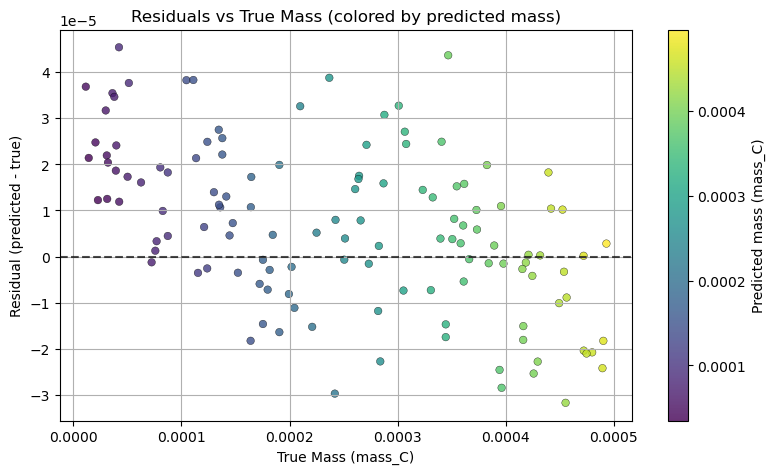

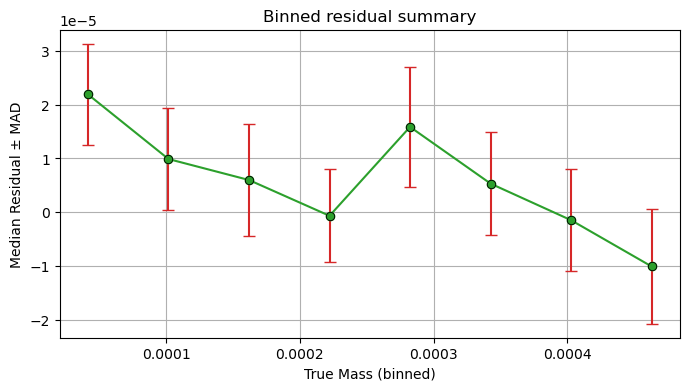

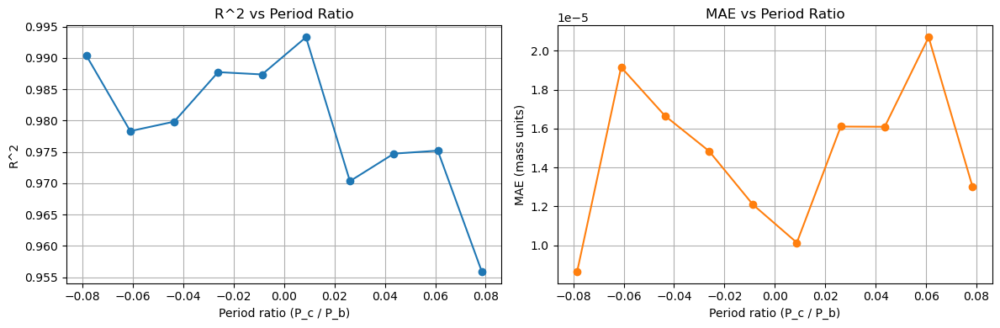

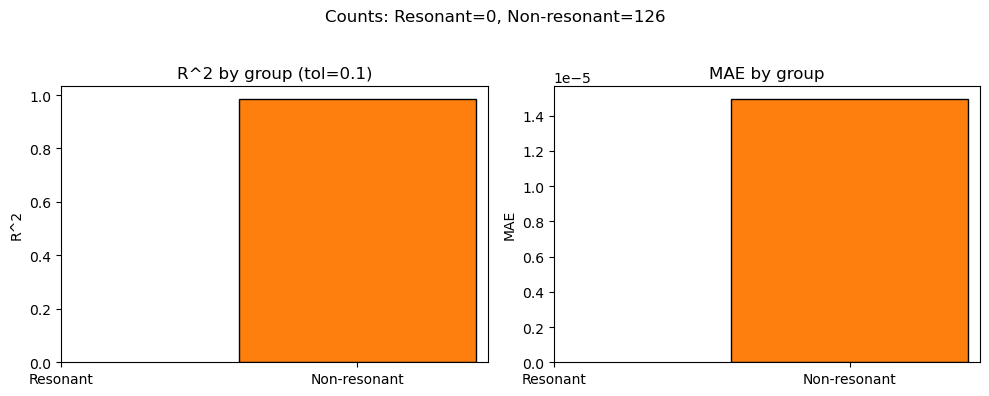

Overall test samples: 126
Resonant samples: 0 Non-resonant samples: 126
Resonant metrics: {'R2': nan, 'MAE': nan, 'N': 0}
Non-resonant metrics: {'R2': 0.9833054611123214, 'MAE': 1.491755930731723e-05, 'N': 126}


In [20]:
import torch

plt.rcParams['image.cmap'] = 'viridis'

# --- Parameters from your generator ---
max_transits = 40
phys_period_ratio_idx = 4
rng_state = 42

# --- Prepare data / scaling (prefer existing objects if present) ---
N = len(features)
_, test_idx = train_test_split(np.arange(N), test_size=0.2, random_state=rng_state)

raw_ttv = features[:, :max_transits]
phys_part = features[:, max_transits:]
period_ratio_all = phys_part[:, phys_period_ratio_idx]
period_ratio_test = period_ratio_all[test_idx]

if 'X_scaled' in globals():
    X_scaled_local = X_scaled
elif 'scaler_X' in globals():
    X_scaled_local = scaler_X.transform(features)
else:
    from sklearn.preprocessing import StandardScaler
    scaler_X_local = StandardScaler()
    X_scaled_local = scaler_X_local.fit_transform(features)
    print("Note: `scaler_X` not found — fitted a local scaler for plotting only.")

X_test = X_scaled_local[test_idx]

# Predictions (use existing preds if present; otherwise infer from model + scaler_y)
if 'predictions_actual' in globals() and len(predictions_actual) == len(features):
    preds_actual = predictions_actual[test_idx]
elif 'preds_actual' in globals() and len(preds_actual) == len(features):
    preds_actual = preds_actual[test_idx]
else:
    if 'model' not in globals():
        raise RuntimeError("Model not found. Run training or provide `predictions_actual`.")
    model.eval()
    with torch.no_grad():
        X_test_t = torch.tensor(X_test, dtype=torch.float32)
        preds_scaled = model(X_test_t).cpu().numpy().flatten()
    if 'scaler_y' in globals():
        preds_actual = scaler_y.inverse_transform(preds_scaled.reshape(-1,1)).flatten()
    else:
        preds_actual = preds_scaled
        print("Warning: `scaler_y` not found; using scaled predictions (units differ).")

if 'mass_labels' in globals():
    y_test_actual = mass_labels[test_idx]
elif 'y_test_actual' in globals():
    y_test_actual = y_test_actual
else:
    raise RuntimeError("True mass labels not found as `mass_labels` or `y_test_actual`.")

residuals = preds_actual - y_test_actual

# -------- Residuals vs True Mass (scatter with colorbar) --------
fig, ax = plt.subplots(1,1, figsize=(8,5))
sc = ax.scatter(y_test_actual, residuals, c=preds_actual, cmap='viridis',
                edgecolors='k', linewidths=0.3, alpha=0.8, s=30)
ax.axhline(0, color='k', linestyle='--', alpha=0.7)
ax.set_xlabel('True Mass (mass_C)')
ax.set_ylabel('Residual (predicted - true)')
ax.set_title('Residuals vs True Mass (colored by predicted mass)')
ax.grid(True)

# Colorbar: shows predicted-mass → color mapping
cbar = fig.colorbar(sc, ax=ax)
cbar.set_label('Predicted mass (mass_C)')

plt.tight_layout()
plt.show()

# -------- Binned median ± MAD --------
nbins = 8
bins = np.linspace(y_test_actual.min(), y_test_actual.max(), nbins+1)
bin_centers = 0.5*(bins[:-1] + bins[1:])
med = []
mad = []
for i in range(nbins):
    sel = (y_test_actual >= bins[i]) & (y_test_actual < bins[i+1])
    if sel.sum() == 0:
        med.append(np.nan); mad.append(np.nan)
    else:
        m = np.median(residuals[sel])
        med.append(m)
        mad.append(np.median(np.abs(residuals[sel] - m)))

plt.figure(figsize=(8,4))
plt.errorbar(bin_centers, med, yerr=mad, fmt='o-', color='C2', ecolor='C3', capsize=4)
plt.scatter(bin_centers, med, color='C2', edgecolors='k', linewidths=0.6, zorder=5)
plt.xlabel('True Mass (binned)')
plt.ylabel('Median Residual ± MAD')
plt.title('Binned residual summary')
plt.grid(True)
plt.show()

# -------- Scores vs Period Ratio --------
nbins = 10
bins = np.linspace(period_ratio_test.min(), period_ratio_test.max(), nbins+1)
bin_centers = 0.5*(bins[:-1] + bins[1:])
r2s = []; maes = []; counts = []
for i in range(nbins):
    sel = (period_ratio_test >= bins[i]) & (period_ratio_test < bins[i+1])
    counts.append(sel.sum())
    if sel.sum() < 2:
        r2s.append(np.nan); maes.append(np.nan)
    else:
        ytrue = y_test_actual[sel]; ypred = preds_actual[sel]
        r2s.append(r2_score(ytrue, ypred)); maes.append(mean_absolute_error(ytrue, ypred))

fig, ax = plt.subplots(1,2, figsize=(12,4))
ax[0].plot(bin_centers, r2s, 'o-', color='C0'); ax[0].set_xlabel('Period ratio (P_c / P_b)'); ax[0].set_ylabel('R^2'); ax[0].grid(True); ax[0].set_title('R^2 vs Period Ratio')
ax[1].plot(bin_centers, maes, 'o-', color='C1'); ax[1].set_xlabel('Period ratio (P_c / P_b)'); ax[1].set_ylabel('MAE (mass units)'); ax[1].grid(True); ax[1].set_title('MAE vs Period Ratio')
plt.tight_layout(); plt.show()

# -------- Resonant vs Non-resonant grouping --------
resonances = [(2,1),(3,2),(4,3),(5,4),(3,1)]
tol = 0.1
is_res = np.zeros_like(period_ratio_test, dtype=bool)
for (n,d) in resonances:
    is_res |= np.abs(period_ratio_test - (n/d)) < tol

def group_metrics(mask):
    if mask.sum() < 2:
        return {'R2': np.nan, 'MAE': np.nan, 'N': int(mask.sum())}
    ytrue = y_test_actual[mask]; ypred = preds_actual[mask]
    return {'R2': r2_score(ytrue, ypred), 'MAE': mean_absolute_error(ytrue, ypred), 'N': int(mask.sum())}

metrics_res = group_metrics(is_res); metrics_nonres = group_metrics(~is_res)
labels = ['Resonant', 'Non-resonant']
r2_vals = [metrics_res['R2'], metrics_nonres['R2']]
mae_vals = [metrics_res['MAE'], metrics_nonres['MAE']]
ns = [metrics_res['N'], metrics_nonres['N']]

x = np.arange(len(labels))
fig, ax = plt.subplots(1,2, figsize=(10,4))
ax[0].bar(x, r2_vals, color=['C0','C1'], edgecolor='k'); ax[0].set_xticks(x); ax[0].set_xticklabels(labels); ax[0].set_ylabel('R^2'); ax[0].set_title(f'R^2 by group (tol={tol})')
ax[1].bar(x, mae_vals, color=['C0','C1'], edgecolor='k'); ax[1].set_xticks(x); ax[1].set_xticklabels(labels); ax[1].set_ylabel('MAE'); ax[1].set_title('MAE by group')
plt.suptitle(f'Counts: Resonant={ns[0]}, Non-resonant={ns[1]}'); plt.tight_layout(rect=[0,0,1,0.95]); plt.show()

# -------- Summary --------
print('Overall test samples:', len(test_idx))
print('Resonant samples:', ns[0], 'Non-resonant samples:', ns[1])
print('Resonant metrics:', metrics_res)
print('Non-resonant metrics:', metrics_nonres)

**Analyzing them one by one**:
---


- X-axis: True value of planet C’s mass (from your simulation).
- Y-axis: Residual = Predicted mass − True mass.
- Zero line: Dashed horizontal line at 0; perfect predictions would hug this line.
- Color: Each point’s color shows the predicted mass for that case (purple = low prediction, yellow = high prediction, and so on)
- Each dot: One sample in the test set.


> Tight clustering near zero: Most points are within a few $10^-5$ of zero, which means the model is doing a good job and isn’t making systematically huge errors.

>  For small true masses (<~0.00015), almost all the residuals are positive (the points are above zero). This means the model tends to over-predict at the low-mass end.  At higher masses, residuals scatter on both sides of zero (some over, some under-estimate), and are more symmetrically distributed—model is more balanced at the high-mass end.

> For low true mass, the predicted mass (color) is typically greater than the true mass (purple turning blue/green). For high true mass, the colors (predicted values) closely follow the true values (more yellow at right), so the predictions are more accurate and less biased there.


![alt text](output7.png)

- X-axis: True mass of planet C, binned into several intervals.
- Y-axis: Median residual (predicted mass − true mass) for each bin, in units of 10^-5
- Green line: Connects the median residual in each mass bin.
- Red error bars: Indicate the spread of the residuals in each bin, specifically the Median Absolute Deviation (MAD).

> At the lowest masses, the model tends to **overpredict** (median residual > 0 , around 2.2 × 10^−5). As true mass increases, the residuals tend downward and cross zero, meaning bias decreases and even slightly **underpredicts** for the highest-mass bins.

> The length of the red bars shows how variable the prediction error is within each bin. It’s relatively constant across all bins, though perhaps a bit larger at low and mid masses.

---
The model is overall reliable across the full mass range, but solutions for low-mass perturbers should be taken with a pinch of salt.


![alt text](output8.png)

**Left Plot: $R^2$ vs Period Ratio ( $P_c / P_b$ )**

- Y-axis: $R^2$ (**coefficient of determination**) — a measure of how well the model’s predictions match the actual data (1.0 is perfect).
- X-axis: Period ratio offset ($P_c / P_b$), i.e., how close each system is to the target resonance.

**Interpretation**:
$R^2$ is generally very high ( ∼ 0.98 − 0.99 ), meaning the model predicts well across all period ratios. There is a small dip in $R^2$ near certain values (e.g., just above 0.02 and at the upper edge), indicating slightly worse predictions near some period ratio offsets. The best performance (highest $R^2$ ) seems to cluster near the resonance center (close to zero on the X-axis), with deterioration as you move away from resonance.


**Right Plot: MAE vs Period Ratio**

- Y-axis: MAE (**Mean Absolute Error**), in mass units (10^− 5).
- X-axis: Period ratio offset, as above.
    
**Interpretation**: MAE is lowest (best) near the resonance (period ratio offset ≈ 0 ), around 0.9 × 10^-5 . MAE increases (worse accuracy) as you move away, especially for positive offsets around +0.06 .There are some fluctuations, but again, the lowest error is near resonance.

---

These plots show that the model most accurately infers perturber mass when the system is *near resonance* (maximal, clean TTV features), while its accuracy slightly degrades further from resonance where TTV signatures are subtler or more ambiguous.

![alt text](output9.png)

There is no resonance in our entire dataset... yikes, that might be because we uniformly sampled our periods for planet B and C earlier...

![alt text](output10.png)

---
# Work in Progress (WIP)

Lets rewrite the code and deliberately input resonances. 100 Simulations.

Starting data generation with extra physical parameters (including resonant sampling)...
  Running simulation 10/1000...
  Running simulation 20/1000...
  Running simulation 30/1000...
  Running simulation 40/1000...
  Running simulation 50/1000...
  Running simulation 60/1000...
  Running simulation 70/1000...
  Running simulation 80/1000...
  Running simulation 90/1000...
  Running simulation 100/1000...
  Running simulation 110/1000...
  Running simulation 120/1000...
  Running simulation 130/1000...
  Running simulation 140/1000...
  Running simulation 150/1000...
  Running simulation 160/1000...
  Running simulation 170/1000...
  Running simulation 180/1000...
  Running simulation 190/1000...
  Running simulation 200/1000...
  Running simulation 210/1000...
  Running simulation 220/1000...
  Running simulation 230/1000...
  Running simulation 240/1000...
  Running simulation 250/1000...
  Running simulation 260/1000...
  Running simulation 270/1000...
  Running simulation 280/1000

C:\Users\rishy\AppData\Local\Temp\ipykernel_6356\120870297.py:250: RuntimeWarning: invalid value encountered in power
  P_b_all = a_b_all ** 1.5


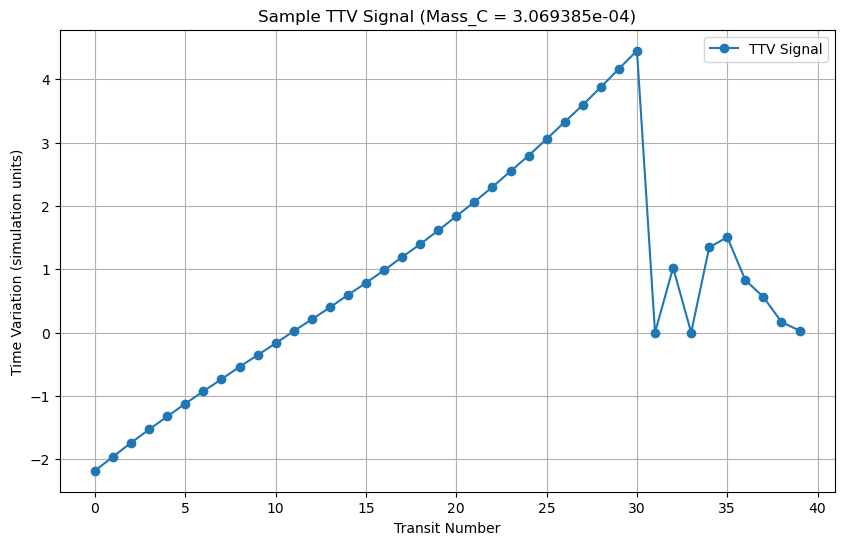


Starting model training...
Epoch [10/50], Train Loss: 0.16460576, Val Loss: 0.04257318
Epoch [20/50], Train Loss: 0.12773691, Val Loss: 0.02521241
Early stopping at epoch 29
Training complete.

--- Testing the trained model ---
Test MSE: 0.0000000004
Test MAE: 0.0000162734

Sample predictions:
  Actual: 4.070517e-04, Predicted: 3.795207e-04
  Actual: 2.094280e-04, Predicted: 1.902214e-04
  Actual: 4.532226e-05, Predicted: 7.436905e-05
  Actual: 4.413261e-04, Predicted: 4.235629e-04
  Actual: 2.469301e-04, Predicted: 2.032573e-04


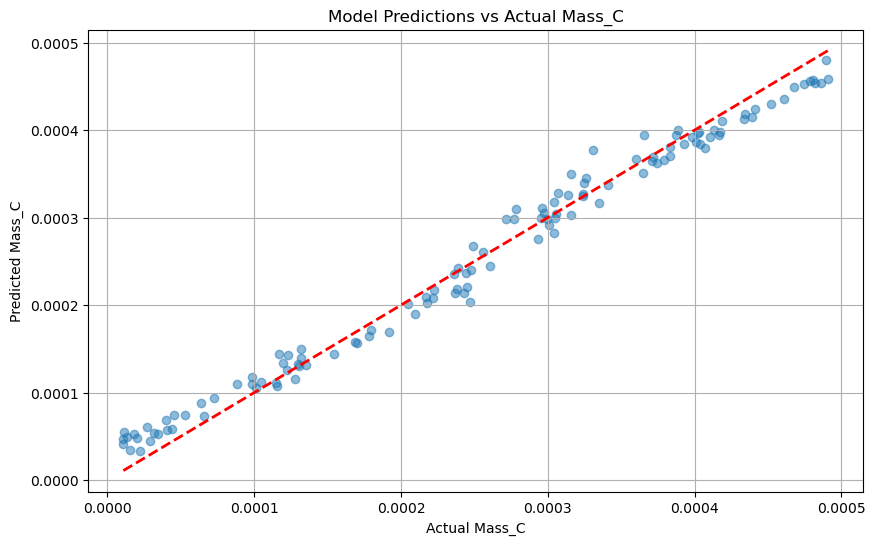

In [30]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import torch
import torch.nn as nn
import torch.optim as optim
import rebound

#-------------------------------------------------------------------------------
# Transit detection (unchanged logic; works with small inclinations)
#-------------------------------------------------------------------------------
def detect_transits(sim, planet_index, star_index=0, max_transits=50, integration_time=200):
    transit_times = []
    dt = 0.0001
    star = sim.particles[star_index]
    planet = sim.particles[planet_index]
    prev_y = planet.y - star.y
    time = 0
    while time < integration_time and len(transit_times) < max_transits:
        sim.integrate(sim.t + dt)
        time = sim.t
        curr_y = planet.y - star.y
        if prev_y * curr_y < 0:
            x_rel = planet.x - star.x
            if x_rel > 0:
                transit_times.append(time)
        prev_y = curr_y
    return np.array(transit_times)

def calculate_ttvs(transit_times_perturbed, transit_times_unperturbed):
    min_len = min(len(transit_times_perturbed), len(transit_times_unperturbed))
    if min_len == 0:
        return np.array([])
    ttvs = transit_times_perturbed[:min_len] - transit_times_unperturbed[:min_len]
    return ttvs

#-------------------------------------------------------------------------------
# Data generator with extra physical parameters encoded as features
#-------------------------------------------------------------------------------
def generate_simulation_data(num_simulations=1000, max_transits=40, integration_time=200,
                             resonant_frac=0.20, resonances=[(2,1),(3,2),(5,3)], res_width=0.02):
    """
    Same return as before: (features, masses, periods)

    New behavior:
      - With probability `resonant_frac` each simulation is sampled *near* one of the
        `resonances` (e.g. (2,1) means P_c/P_b ~ 2.0) within ±`res_width` (fractional).
      - Otherwise a_c is drawn uniformly as before.
    """
    print("Starting data generation with extra physical parameters (including resonant sampling)...")
    try:
        sim_unperturbed = rebound.Simulation()
        sim_unperturbed.add(m=1.0)              # Star
        sim_unperturbed.add(m=1e-4, a=1.0)      # Planet B nominal
        sim_unperturbed.move_to_com()
        unperturbed_transits = detect_transits(sim_unperturbed, planet_index=1,
                                               max_transits=max_transits, integration_time=integration_time)
        if len(unperturbed_transits) < max_transits:
            print(f"Warning: Only found {len(unperturbed_transits)} unperturbed transits (max_transits={max_transits})")
            max_transits = len(unperturbed_transits)
    except Exception as e:
        print(f"Error generating unperturbed sim: {e}")
        return np.array([]), np.array([]), np.array([])

    all_features = []
    all_masses = []
    all_periods = []
    failed_sims = 0

    for i in range(num_simulations):
        if (i + 1) % 10 == 0:
            print(f"  Running simulation {i+1}/{num_simulations}...")
        try:
            # Planet B (the transiting planet) - allow modest variation
            a_b = np.random.uniform(0.9, 1.1)
            m_b = np.random.uniform(0.5e-4, 1.5e-4)
            e_b = np.random.uniform(0.0, 0.2)
            omega_b = np.random.uniform(0.0, 2*np.pi)
            M_b = np.random.uniform(0.0, 2*np.pi)
            inc_b = np.deg2rad(np.random.normal(0.0, 1.0))

            # Decide whether to force near-resonant sample
            make_resonant = (np.random.rand() < resonant_frac)
            if make_resonant:
                # pick a resonance and make P_c close to target_ratio * P_b
                num, den = resonances[np.random.randint(len(resonances))]
                target_ratio = float(num) / float(den)
                P_b = a_b**1.5
                # P_c within ±res_width fraction of target_ratio * P_b
                frac = np.random.uniform(1.0 - res_width, 1.0 + res_width)
                P_c = target_ratio * P_b * frac
                a_c = P_c ** (2/3)
            else:
                # non-resonant: sample a_c uniformly in allowed range
                a_c = np.random.uniform(1.2, 2.0)

            # Planet C (perturber) other params
            m_c = np.random.uniform(1e-5, 5e-4)
            e_c = np.random.uniform(0.0, 0.2)
            omega_c = np.random.uniform(0.0, 2*np.pi)
            M_c = np.random.uniform(0.0, 2*np.pi)
            inc_c_deg = np.clip(np.random.normal(0.0, 2.5), -5.0, 5.0)
            inc_c = np.deg2rad(inc_c_deg)

            # Compute orbital periods
            P_b = a_b**1.5
            P_c = a_c**1.5
            period_ratio = P_c / P_b

            # Build simulation
            sim = rebound.Simulation()
            sim.add(m=1.0)
            sim.add(m=m_b, a=a_b, e=e_b, inc=inc_b, omega=omega_b, M=M_b)
            sim.add(m=m_c, a=a_c, e=e_c, inc=inc_c, omega=omega_c, M=M_c)
            sim.move_to_com()

            perturbed_transits = detect_transits(sim, planet_index=1,
                                                max_transits=max_transits, integration_time=integration_time)
            ttvs = calculate_ttvs(perturbed_transits, unperturbed_transits)

            if len(ttvs) >= max_transits:
                ttv_vec = ttvs[:max_transits]

                dM = M_c - M_b
                sin_dM = np.sin(dM); cos_dM = np.cos(dM)
                sin_omega_b = np.sin(omega_b); cos_omega_b = np.cos(omega_b)
                sin_omega_c = np.sin(omega_c); cos_omega_c = np.cos(omega_c)
                sin_inc_c = np.sin(inc_c); cos_inc_c = np.cos(inc_c)

                phys_features = np.array([
                    m_b, a_b,
                    m_c, a_c,
                    period_ratio,
                    sin_dM, cos_dM,
                    e_b, e_c,
                    sin_omega_b, cos_omega_b,
                    sin_omega_c, cos_omega_c,
                    sin_inc_c, cos_inc_c
                ], dtype=float)

                sample_features = np.concatenate([ttv_vec, phys_features])
                all_features.append(sample_features)
                all_masses.append(m_c)
                all_periods.append(P_c)
            else:
                failed_sims += 1

        except Exception as e:
            failed_sims += 1
            if failed_sims <= 5:
                print(f"  Simulation {i+1} failed: {e}")

    print(f"Data generation complete. Generated {len(all_features)} samples. Failed: {failed_sims}/{num_simulations}")
    if len(all_features) == 0:
        return np.array([]), np.array([]), np.array([])

    return np.array(all_features), np.array(all_masses), np.array(all_periods)

#-------------------------------------------------------------------------------
# Neural network (unchanged architecture but note dynamic input size)
#-------------------------------------------------------------------------------
class MassPredictor(nn.Module):
    def __init__(self, input_size):
        super(MassPredictor, self).__init__()
        self.network = nn.Sequential(
            nn.Linear(input_size, 128),
            nn.BatchNorm1d(128),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(128, 64),
            nn.BatchNorm1d(64),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(64, 32),
            nn.ReLU(),
            nn.Linear(32, 1)
        )

    def forward(self, x):
        return self.network(x)

# Training function (same as before)
def train_model(model, X_train, y_train, X_val, y_val, epochs=50, batch_size=16):
    print("\nStarting model training...")
    X_train_t = torch.tensor(X_train, dtype=torch.float32)
    y_train_t = torch.tensor(y_train, dtype=torch.float32).view(-1, 1)
    X_val_t = torch.tensor(X_val, dtype=torch.float32)
    y_val_t = torch.tensor(y_val, dtype=torch.float32).view(-1, 1)

    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=0.001)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=5)

    best_val_loss = float('inf')
    patience_counter = 0
    max_patience = 10

    for epoch in range(epochs):
        model.train()
        train_loss = 0.0
        indices = torch.randperm(len(X_train_t))
        for i in range(0, len(X_train_t), batch_size):
            batch_indices = indices[i:i+batch_size]
            batch_X = X_train_t[batch_indices]
            batch_y = y_train_t[batch_indices]
            outputs = model(batch_X)
            loss = criterion(outputs, batch_y)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            train_loss += loss.item() * len(batch_X)

        model.eval()
        with torch.no_grad():
            val_outputs = model(X_val_t)
            val_loss = criterion(val_outputs, y_val_t)

        scheduler.step(val_loss)

        if (epoch + 1) % 10 == 0:
            print(f'Epoch [{epoch+1}/{epochs}], Train Loss: {train_loss/len(X_train_t):.8f}, Val Loss: {val_loss.item():.8f}')

        if val_loss < best_val_loss:
            best_val_loss = val_loss
            patience_counter = 0
            best_model_state = {k: v.clone() for k, v in model.state_dict().items()}
        else:
            patience_counter += 1
            if patience_counter >= max_patience:
                print(f"Early stopping at epoch {epoch+1}")
                model.load_state_dict(best_model_state)
                break

    print("Training complete.")
    return model

#-------------------------------------------------------------------------------
# Main block: generate data, calculate resonance, save, scale, train, evaluate
#-------------------------------------------------------------------------------
if __name__ == "__main__":
    # 1. Generate data with extended physical parameters
    features, mass_labels, period_labels = generate_simulation_data(num_simulations=1000, max_transits=40, integration_time=200)

    if len(features) < 10:
        print("\nNot enough data generated to train. Increase `num_simulations` or check failures.")
    else:
        # 2. Calculate resonance: period ratio (P_c / P_b)
        a_b_all = features[:, 1]  # a_b is the second column
        P_b_all = a_b_all ** 1.5
        resonance = period_labels / P_b_all

        # 3. Save all data to npz
        np.savez("ttv_dataset_with_resonance.npz",
                 features=features,
                 mass_labels=mass_labels,
                 period_labels=period_labels,
                 resonance=resonance)
        print("Saved features, mass_labels, period_labels, and resonance to ttv_dataset_with_resonance.npz")

        # 4. Separate raw TTVs (for plotting) from physical features (optional)
        max_transits = 40
        raw_ttv = features[:, :max_transits]           # raw TTVs before scaling
        phys_part = features[:, max_transits:]         # additional physical features appended

        # 5. Scale features and labels
        scaler_X = StandardScaler()
        scaler_y = StandardScaler()
        X_scaled = scaler_X.fit_transform(features)    # scale entire feature vector
        y_scaled = scaler_y.fit_transform(mass_labels.reshape(-1, 1)).flatten()

        # 6. Train/test split (also keep period labels for analysis)
        X_train, X_test, y_train, y_test, periods_train, periods_test = train_test_split(
            X_scaled, y_scaled, period_labels, test_size=0.2, random_state=42
        )

        # 7. Further split training into train/val
        X_train, X_val, y_train, y_val, periods_train, periods_val = train_test_split(
            X_train, y_train, periods_train, test_size=0.2, random_state=42
        )

        # 8. Visualize a sample raw TTV signal (unscaled)
        plt.figure(figsize=(10, 6))
        plt.plot(raw_ttv[0], 'o-', label='TTV Signal')
        plt.title(f'Sample TTV Signal (Mass_C = {mass_labels[0]:.6e})')
        plt.xlabel('Transit Number')
        plt.ylabel('Time Variation (simulation units)')
        plt.legend()
        plt.grid(True)
        plt.show()

        # 9. Build and train the model (input size is full feature vector length)
        input_size = features.shape[1]
        model = MassPredictor(input_size=input_size)
        model = train_model(model, X_train, y_train, X_val, y_val, epochs=50)

        # 10. Evaluate on test set
        print("\n--- Testing the trained model ---")
        model.eval()
        with torch.no_grad():
            X_test_t = torch.tensor(X_test, dtype=torch.float32)
            predictions = model(X_test_t).numpy().flatten()
            predictions_actual = scaler_y.inverse_transform(predictions.reshape(-1, 1)).flatten()
            y_test_actual = scaler_y.inverse_transform(y_test.reshape(-1, 1)).flatten()

            mse = np.mean((predictions_actual - y_test_actual)**2)
            mae = np.mean(np.abs(predictions_actual - y_test_actual))
            print(f"Test MSE: {mse:.10f}")
            print(f"Test MAE: {mae:.10f}")
            print("\nSample predictions:")
            for i in range(min(5, len(y_test_actual))):
                print(f"  Actual: {y_test_actual[i]:.6e}, Predicted: {predictions_actual[i]:.6e}")

        # 11. Plot predictions vs actual
        plt.figure(figsize=(10, 6))
        plt.scatter(y_test_actual, predictions_actual, alpha=0.5)
        plt.plot([y_test_actual.min(), y_test_actual.max()],
                 [y_test_actual.min(), y_test_actual.max()], 'r--', lw=2)
        plt.xlabel('Actual Mass_C')
        plt.ylabel('Predicted Mass_C')
        plt.title('Model Predictions vs Actual Mass_C')
        plt.grid(True)
        plt.show()

Starting data generation with extra physical parameters (including resonant sampling)...
  Running simulation 10/10...
Data generation complete. Generated 10 samples with 40 features. Failed: 0/10
features shape: (10, 40)
mass_labels shape: (10,)
period_labels shape: (10,)
Resonance stats: min nan max nan
First 10 resonance values: [nan nan nan nan nan nan nan nan nan nan]
Saved features, mass_labels, period_labels, and resonance to ttv_dataset_with_resonance.npz


C:\Users\rishy\AppData\Local\Temp\ipykernel_6356\1643631840.py:250: RuntimeWarning: invalid value encountered in power
  P_b_all = a_b_all ** 1.5
C:\Users\rishy\AppData\Local\Temp\ipykernel_6356\1643631840.py:252: RuntimeWarning: All-NaN slice encountered
  print("Resonance stats: min", np.nanmin(resonance), "max", np.nanmax(resonance))


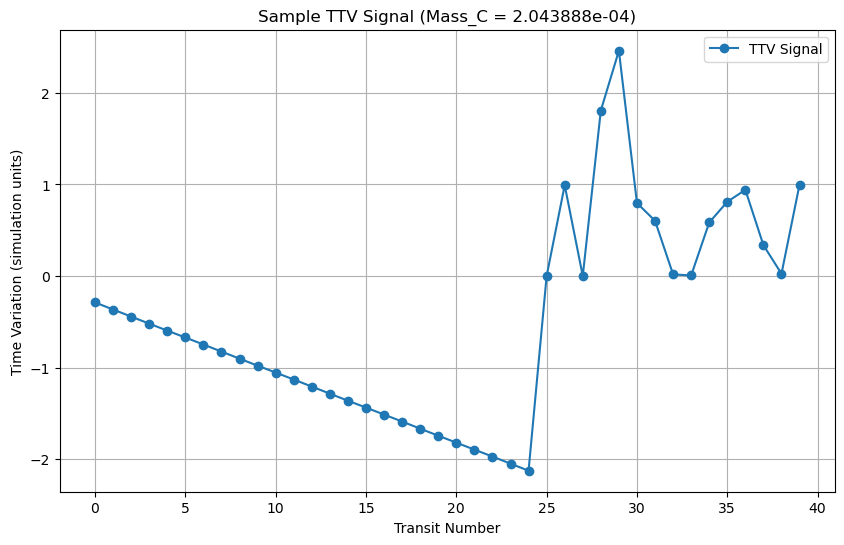


Starting model training...
Epoch [10/50], Train Loss: 0.79443544, Val Loss: 0.64150250
Early stopping at epoch 11
Training complete.

--- Testing the trained model ---
Test MSE: 0.0000000120
Test MAE: 0.0001082969

Sample predictions:
  Actual: 1.190974e-04, Predicted: 2.444620e-04
  Actual: 1.479393e-04, Predicted: 2.391686e-04


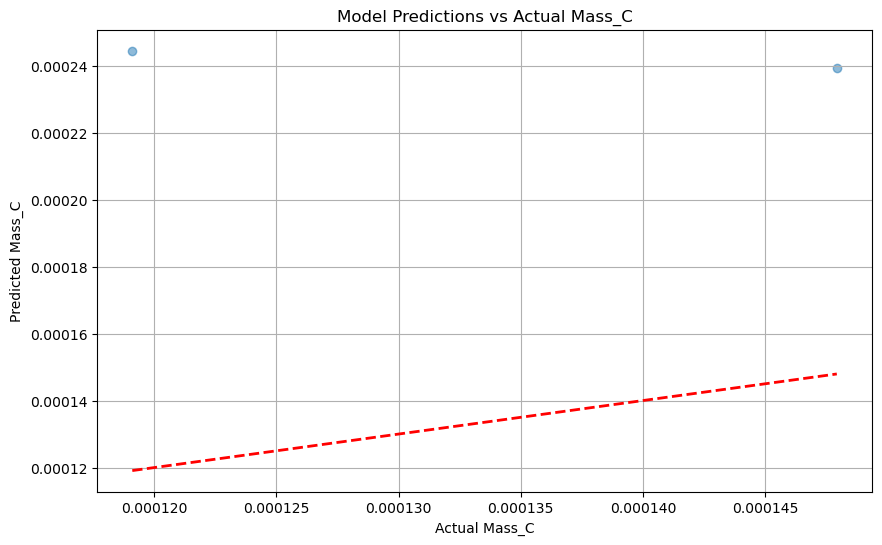

In [49]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import torch
import torch.nn as nn
import torch.optim as optim
import rebound

#-------------------------------------------------------------------------------
# Transit detection (unchanged logic; works with small inclinations)
#-------------------------------------------------------------------------------
def detect_transits(sim, planet_index, star_index=0, max_transits=25, integration_time=400):
    transit_times = []
    dt = 0.0001
    star = sim.particles[star_index]
    planet = sim.particles[planet_index]
    prev_y = planet.y - star.y
    time = 0
    while time < integration_time and len(transit_times) < max_transits:
        sim.integrate(sim.t + dt)
        time = sim.t
        curr_y = planet.y - star.y
        if prev_y * curr_y < 0:
            x_rel = planet.x - star.x
            if x_rel > 0:
                transit_times.append(time)
        prev_y = curr_y
    return np.array(transit_times)

def calculate_ttvs(transit_times_perturbed, transit_times_unperturbed):
    min_len = min(len(transit_times_perturbed), len(transit_times_unperturbed))
    if min_len == 0:
        return np.array([])
    ttvs = transit_times_perturbed[:min_len] - transit_times_unperturbed[:min_len]
    return ttvs

#-------------------------------------------------------------------------------
# Data generator with extra physical parameters encoded as features
#-------------------------------------------------------------------------------
def generate_simulation_data(num_simulations=10, max_transits=25, integration_time=400,
                             resonant_frac=0.20, resonances=[(2,1),(3,2),(5,3)], res_width=0.02):
    print("Starting data generation with extra physical parameters (including resonant sampling)...")
    try:
        sim_unperturbed = rebound.Simulation()
        sim_unperturbed.add(m=1.0)              # Star
        sim_unperturbed.add(m=1e-4, a=1.0)      # Planet B nominal
        sim_unperturbed.move_to_com()
        unperturbed_transits = detect_transits(sim_unperturbed, planet_index=1,
                                               max_transits=max_transits, integration_time=integration_time)
        max_transits = min(max_transits, len(unperturbed_transits))
        if len(unperturbed_transits) < max_transits:
            print(f"Warning: Only found {len(unperturbed_transits)} unperturbed transits (max_transits={max_transits})")
            max_transits = len(unperturbed_transits)
    except Exception as e:
        print(f"Error generating unperturbed sim: {e}")
        return np.array([]), np.array([]), np.array([])

    all_features = []
    all_masses = []
    all_periods = []
    failed_sims = 0

    for i in range(num_simulations):
        if (i + 1) % 10 == 0:
            print(f"  Running simulation {i+1}/{num_simulations}...")
        try:
            # Planet B (the transiting planet) - allow modest variation
            a_b = np.random.uniform(0.9, 1.1)
            m_b = np.random.uniform(0.5e-4, 1.5e-4)
            e_b = np.random.uniform(0.0, 0.2)
            omega_b = np.random.uniform(0.0, 2*np.pi)
            M_b = np.random.uniform(0.0, 2*np.pi)
            inc_b = np.deg2rad(np.random.normal(0.0, 1.0))

            # Decide whether to force near-resonant sample
            make_resonant = (np.random.rand() < resonant_frac)
            if make_resonant:
                num, den = resonances[np.random.randint(len(resonances))]
                target_ratio = float(num) / float(den)
                P_b = a_b**1.5
                frac = np.random.uniform(1.0 - res_width, 1.0 + res_width)
                P_c = target_ratio * P_b * frac
                a_c = P_c ** (2/3)
            else:
                a_c = np.random.uniform(1.2, 2.0)

            # Planet C (perturber) other params
            m_c = np.random.uniform(1e-5, 5e-4)
            e_c = np.random.uniform(0.0, 0.2)
            omega_c = np.random.uniform(0.0, 2*np.pi)
            M_c = np.random.uniform(0.0, 2*np.pi)
            inc_c_deg = np.clip(np.random.normal(0.0, 2.5), -5.0, 5.0)
            inc_c = np.deg2rad(inc_c_deg)

            # Compute orbital periods
            P_b = a_b**1.5
            P_c = a_c**1.5
            period_ratio = P_c / P_b

            # Build simulation
            sim = rebound.Simulation()
            sim.add(m=1.0)
            sim.add(m=m_b, a=a_b, e=e_b, inc=inc_b, omega=omega_b, M=M_b)
            sim.add(m=m_c, a=a_c, e=e_c, inc=inc_c, omega=omega_c, M=M_c)
            sim.move_to_com()

            perturbed_transits = detect_transits(sim, planet_index=1,
                                                max_transits=max_transits, integration_time=integration_time)
            ttvs = calculate_ttvs(perturbed_transits, unperturbed_transits)

            if ttvs.shape[0] == max_transits:
                ttv_vec = ttvs[:max_transits]

                dM = M_c - M_b
                sin_dM = np.sin(dM); cos_dM = np.cos(dM)
                sin_omega_b = np.sin(omega_b); cos_omega_b = np.cos(omega_b)
                sin_omega_c = np.sin(omega_c); cos_omega_c = np.cos(omega_c)
                sin_inc_c = np.sin(inc_c); cos_inc_c = np.cos(inc_c)

                phys_features = np.array([
                    m_b, a_b,
                    m_c, a_c,
                    period_ratio,
                    sin_dM, cos_dM,
                    e_b, e_c,
                    sin_omega_b, cos_omega_b,
                    sin_omega_c, cos_omega_c,
                    sin_inc_c, cos_inc_c
                ], dtype=float)

                if phys_features.shape[0] == 15:
                    sample_features = np.concatenate([ttv_vec, phys_features])
                    all_features.append(sample_features)
                    all_masses.append(m_c)
                    all_periods.append(P_c)
                else:
                    failed_sims += 1
                    print(f"Skipped: ttv_vec shape {ttv_vec.shape}, phys_features shape {phys_features.shape}")
            else:
                failed_sims += 1
                print(f"Skipped: ttv_vec shape {ttvs.shape}")

        except Exception as e:
            failed_sims += 1
            if failed_sims <= 5:
                print(f"  Simulation {i+1} failed: {e}")

    features = np.array(all_features)
    mass_labels = np.array(all_masses)
    period_labels = np.array(all_periods)
    print(f"Data generation complete. Generated {features.shape[0]} samples with {features.shape[1] if features.shape[0]>0 else 0} features. Failed: {failed_sims}/{num_simulations}")
    print("features shape:", features.shape)
    print("mass_labels shape:", mass_labels.shape)
    print("period_labels shape:", period_labels.shape)
    if features.shape[0] == 0:
        return np.array([]), np.array([]), np.array([])
    return features, mass_labels, period_labels

#-------------------------------------------------------------------------------
# Neural network (unchanged architecture but note dynamic input size)
#-------------------------------------------------------------------------------
class MassPredictor(nn.Module):
    def __init__(self, input_size):
        super(MassPredictor, self).__init__()
        self.network = nn.Sequential(
            nn.Linear(input_size, 128),
            nn.BatchNorm1d(128),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(128, 64),
            nn.BatchNorm1d(64),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(64, 32),
            nn.ReLU(),
            nn.Linear(32, 1)
        )

    def forward(self, x):
        return self.network(x)

# Training function (same as before)
def train_model(model, X_train, y_train, X_val, y_val, epochs=50, batch_size=16):
    print("\nStarting model training...")
    X_train_t = torch.tensor(X_train, dtype=torch.float32)
    y_train_t = torch.tensor(y_train, dtype=torch.float32).view(-1, 1)
    X_val_t = torch.tensor(X_val, dtype=torch.float32)
    y_val_t = torch.tensor(y_val, dtype=torch.float32).view(-1, 1)

    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=0.001)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=5)

    best_val_loss = float('inf')
    patience_counter = 0
    max_patience = 10

    for epoch in range(epochs):
        model.train()
        train_loss = 0.0
        indices = torch.randperm(len(X_train_t))
        for i in range(0, len(X_train_t), batch_size):
            batch_indices = indices[i:i+batch_size]
            batch_X = X_train_t[batch_indices]
            batch_y = y_train_t[batch_indices]
            outputs = model(batch_X)
            loss = criterion(outputs, batch_y)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            train_loss += loss.item() * len(batch_X)

        model.eval()
        with torch.no_grad():
            val_outputs = model(X_val_t)
            val_loss = criterion(val_outputs, y_val_t)

        scheduler.step(val_loss)

        if (epoch + 1) % 10 == 0:
            print(f'Epoch [{epoch+1}/{epochs}], Train Loss: {train_loss/len(X_train_t):.8f}, Val Loss: {val_loss.item():.8f}')

        if val_loss < best_val_loss:
            best_val_loss = val_loss
            patience_counter = 0
            best_model_state = {k: v.clone() for k, v in model.state_dict().items()}
        else:
            patience_counter += 1
            if patience_counter >= max_patience:
                print(f"Early stopping at epoch {epoch+1}")
                model.load_state_dict(best_model_state)
                break

    print("Training complete.")
    return model

#-------------------------------------------------------------------------------
# Main block: generate data, calculate resonance, save, scale, train, evaluate
#-------------------------------------------------------------------------------
if __name__ == "__main__":
    # 1. Generate data with extended physical parameters
    features, mass_labels, period_labels = generate_simulation_data(num_simulations=10, max_transits=25, integration_time=400)

    if features.shape[0] < 10 or features.shape[1] < 2:
        print("\nNot enough valid data generated to train. Increase `num_simulations` or check failures.")
    else:
        # 2. Calculate resonance: period ratio (P_c / P_b)
        a_b_all = features[:, 1]  # a_b is the second column
        P_b_all = a_b_all ** 1.5
        resonance = period_labels / P_b_all
        print("Resonance stats: min", np.nanmin(resonance), "max", np.nanmax(resonance))
        print("First 10 resonance values:", resonance[:10])

        # 3. Save all data to npz
        np.savez("ttv_dataset_with_resonance.npz",
                 features=features,
                 mass_labels=mass_labels,
                 period_labels=period_labels,
                 resonance=resonance)
        print("Saved features, mass_labels, period_labels, and resonance to ttv_dataset_with_resonance.npz")

        # 4. Separate raw TTVs (for plotting) from physical features (optional)
        max_transits = 40
        raw_ttv = features[:, :max_transits]           # raw TTVs before scaling
        phys_part = features[:, max_transits:]         # additional physical features appended

        # 5. Scale features and labels
        scaler_X = StandardScaler()
        scaler_y = StandardScaler()
        X_scaled = scaler_X.fit_transform(features)    # scale entire feature vector
        y_scaled = scaler_y.fit_transform(mass_labels.reshape(-1, 1)).flatten()

        # 6. Train/test split (also keep period labels for analysis)
        X_train, X_test, y_train, y_test, periods_train, periods_test = train_test_split(
            X_scaled, y_scaled, period_labels, test_size=0.2, random_state=42
        )

        # 7. Further split training into train/val
        X_train, X_val, y_train, y_val, periods_train, periods_val = train_test_split(
            X_train, y_train, periods_train, test_size=0.2, random_state=42
        )

        # 8. Visualize a sample raw TTV signal (unscaled)
        plt.figure(figsize=(10, 6))
        plt.plot(raw_ttv[0], 'o-', label='TTV Signal')
        plt.title(f'Sample TTV Signal (Mass_C = {mass_labels[0]:.6e})')
        plt.xlabel('Transit Number')
        plt.ylabel('Time Variation (simulation units)')
        plt.legend()
        plt.grid(True)
        plt.show()

        # 9. Build and train the model (input size is full feature vector length)
        input_size = features.shape[1]
        model = MassPredictor(input_size=input_size)
        model = train_model(model, X_train, y_train, X_val, y_val, epochs=50)

        # 10. Evaluate on test set
        print("\n--- Testing the trained model ---")
        model.eval()
        with torch.no_grad():
            X_test_t = torch.tensor(X_test, dtype=torch.float32)
            predictions = model(X_test_t).numpy().flatten()
            predictions_actual = scaler_y.inverse_transform(predictions.reshape(-1, 1)).flatten()
            y_test_actual = scaler_y.inverse_transform(y_test.reshape(-1, 1)).flatten()

            mse = np.mean((predictions_actual - y_test_actual)**2)
            mae = np.mean(np.abs(predictions_actual - y_test_actual))
            print(f"Test MSE: {mse:.10f}")
            print(f"Test MAE: {mae:.10f}")
            print("\nSample predictions:")
            for i in range(min(5, len(y_test_actual))):
                print(f"  Actual: {y_test_actual[i]:.6e}, Predicted: {predictions_actual[i]:.6e}")

        # 11. Plot predictions vs actual
        plt.figure(figsize=(10, 6))
        plt.scatter(y_test_actual, predictions_actual, alpha=0.5)
        plt.plot([y_test_actual.min(), y_test_actual.max()],
                 [y_test_actual.min(), y_test_actual.max()], 'r--', lw=2)
        plt.xlabel('Actual Mass_C')
        plt.ylabel('Predicted Mass_C')
        plt.title('Model Predictions vs Actual Mass_C')
        plt.grid(True)
        plt.show()

In [ ]:
# --- Sampling physical parameters as in your code ---
m_star = 1.0

a_b = np.random.uniform(0.9, 1.1)
m_b = np.random.uniform(0.5e-4, 1.5e-4)
e_b = np.random.uniform(0.0, 0.2)
omega_b = np.random.uniform(0.0, 2*np.pi)
M_b = np.random.uniform(0.0, 2*np.pi)
inc_b = np.deg2rad(np.random.normal(0.0, 1.0))

resonances = [(2,1),(3,2),(5,3)]
res_width = 0.02
resonant_frac = 0.8
make_resonant = (np.random.rand() < resonant_frac)
if make_resonant:
    num, den = resonances[np.random.randint(len(resonances))]
    target_ratio = float(num) / float(den)
    P_b = a_b**1.5
    frac = np.random.uniform(1.0 - res_width, 1.0 + res_width)
    P_c = target_ratio * P_b * frac
    a_c = P_c ** (2/3)
else:
    a_c = np.random.uniform(1.2, 2.0)

m_c = np.random.uniform(1e-5, 5e-4)
e_c = np.random.uniform(0.0, 0.2)
omega_c = np.random.uniform(0.0, 2*np.pi)
M_c = np.random.uniform(0.0, 2*np.pi)
inc_c_deg = np.clip(np.random.normal(0.0, 2.5), -5.0, 5.0)
inc_c = np.deg2rad(inc_c_deg)

sim = rebound.Simulation()
sim.add(m=m_star)
sim.add(m=m_b, a=a_b, e=e_b, inc=inc_b, omega=omega_b, M=M_b)
sim.add(m=m_c, a=a_c, e=e_c, inc=inc_c, omega=omega_c, M=M_c)
sim.move_to_com()

integration_time = 20 * a_b**1.5   # Make the total simulated time longer
N_steps = 1000                     # Increase the number of animation frames
dt = integration_time / N_steps
positions_b = []
positions_c = []

for _ in range(N_steps):
    sim.integrate(sim.t + dt)
    star = sim.particles[0]
    b = sim.particles[1]
    c = sim.particles[2]
    positions_b.append([b.x-star.x, b.y-star.y])
    positions_c.append([c.x-star.x, c.y-star.y])
positions_b = np.array(positions_b)
positions_c = np.array(positions_c)

# --- Matplotlib animation with black background ---
fig, ax = plt.subplots(figsize=(6,6), facecolor='black')
ax.set_facecolor('black')

limit = 1.1 * max(a_c, a_b) * 1.3
ax.set_xlim(-limit, limit)
ax.set_ylim(-limit, limit)

ax.set_xlabel("x [AU]", color='white')
ax.set_ylabel("y [AU]", color='white')
ax.set_title("Planetary System Animation", color='white')

star_plot, = ax.plot([0], [0], 'o', ms=12, color='yellow', label='Star')
b_plot, = ax.plot([], [], 'o', ms=8, color='cyan', label='Planet B (transit)')
c_plot, = ax.plot([], [], 'o', ms=8, color='magenta', label='Planet C (perturber)')
b_traj, = ax.plot([], [], '-', lw=1, alpha=0.7, color='lightcyan')
c_traj, = ax.plot([], [], '-', lw=1, alpha=0.7, color='violet')

legend = ax.legend(facecolor='black', edgecolor='white', labelcolor='white')
for text in legend.get_texts():
    text.set_color('white')

# Make axes and tick labels white for visibility
ax.tick_params(axis='x', colors='white')
ax.tick_params(axis='y', colors='white')
for spine in ax.spines.values():
    spine.set_edgecolor('white')

def init():
    b_plot.set_data([], [])
    c_plot.set_data([], [])
    b_traj.set_data([], [])
    c_traj.set_data([], [])
    return b_plot, c_plot, b_traj, c_traj

def animate(i):
    if i == 0:
        b_traj.set_data([], [])
        c_traj.set_data([], [])
    b_plot.set_data(positions_b[i,0], positions_b[i,1])
    c_plot.set_data(positions_c[i,0], positions_c[i,1])
    b_traj.set_data(positions_b[:i+1,0], positions_b[:i+1,1])
    c_traj.set_data(positions_c[:i+1,0], positions_c[:i+1,1])
    return b_plot, c_plot, b_traj, c_traj

ani = animation.FuncAnimation(
    fig, animate, frames=N_steps, interval=20, blit=True, init_func=init)

ani.save('planetary_system.gif', writer='pillow')

from IPython.display import HTML
plt.close(fig)  # <-- Add this line!
HTML(ani.to_jshtml())

C:\Users\rishy\AppData\Local\Temp\ipykernel_6356\3294387401.py:98: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  b_plot.set_data(positions_b[i,0], positions_b[i,1])
C:\Users\rishy\AppData\Local\Temp\ipykernel_6356\3294387401.py:99: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  c_plot.set_data(positions_c[i,0], positions_c[i,1])
C:\Users\rishy\AppData\Local\Temp\ipykernel_6356\3294387401.py:98: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  b_plot.set_data(positions_b[i,0], positions_b[i,1])
C:\Users\rishy\AppData\Local\Temp\ipykernel_6356\3294387401.py:99: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  c_plot.set_data(position